# Задача 7. Компьютерное зрение: задача сегментации

- Dataset: https://drive.google.com/file/d/11wp4Bm-hEVwmZq8GmqbLpKpJiqvDSNAe/view?usp=sharing --- тут лежит датасет который мы будем использовать.

Мы хотим обучить наш unet на небольшом датасете. Нужно заполнить репорт и сделать выводы.


- [x] Сделать train/test split (или кросс-валидацию), зафиксировать все сиды чтобы более-менее воспроизводились результаты. Добавить метрику **jaccard index**. Переобучиться на одном батче (например 4 картинки), попробовать получить почти идеальное качество, посмотреть получилось или нет. Посчитать метрики для батча и для теста. Обучить на всем train, построить train/val кривые для loss и для **jaccard index**, подобрать оптимальное время обучения (количество шагов) для фиксированных параметров. Визуализировать topN самых плохих предсказаний.
- [x] Попробовать улучшить качество не меняя архитектуру: аугментации, гиперпараметры. Сделать test time аугментации через horizontal flip, посмотреть улучшается ли что-то.
- [x] Попробовать улучшить качество изменяя архитектуру.
- [ ] * (**+2 балла**) Сделать train/test разбиение. Внутри train сделать 5fold, обучить 5 моделей. Построить кривые обучения для каждого фолда. Предсказать тест со всех 5 моделей и сагрегировать предсказания (до расчета метрик), сравнить с одной моделью обученной на всех данных. Сравнить с моделями обученными на фолдах. Сравнить плохие предсказания теста на разных фолдах. Ошибается на одних и тех же семплах или на разных?
- [x] * (**+3 балла**) Сделать unet с pretrained энкодером (можно взять vgg или resnet18/34), сравнить с предыдущими пунктами.


## Imports

In [1]:
import os
import random
import shutil

import cv2
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

import torch
from PIL import Image
from torch import nn
from torch.utils.data import Dataset

In [2]:
def set_seeds():
    # fix random seeds
    SEED_VALUE = 42

    random.seed(SEED_VALUE)
    np.random.seed(SEED_VALUE)
    torch.manual_seed(SEED_VALUE)

    if torch.cuda.is_available():
        torch.cuda.manual_seed(SEED_VALUE)
        torch.cuda.manual_seed_all(SEED_VALUE)
        torch.backends.cudnn.deterministic = True
        torch.backends.cudnn.benchmark = True
set_seeds()

## Dataset

### Preprocessing

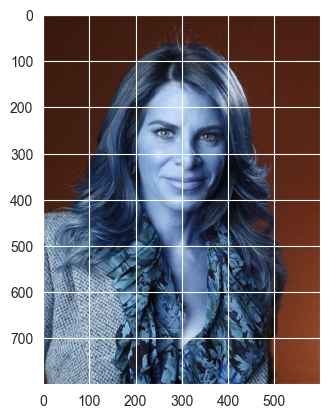

In [3]:
img = cv2.imread("F:\spbu-projects\ml-course-spbu\data\segmentation\images/1803151818-00001027.jpg", cv2.IMREAD_UNCHANGED)
mask = cv2.imread("F:\spbu-projects\ml-course-spbu\data\segmentation\masks/1803151818-00001027.jpg", cv2.IMREAD_UNCHANGED)
plt.imshow(img)

In [4]:
# in_path = "F:\spbu-projects\ml-course-spbu\data\segmentation"
# out_path = "F:\spbu-projects\ml-course-spbu\data\seg_splitted_dataset"
# 
# def get_dataset(in_path, out_path, train_size=0.7, val_size=0.2, test_size=0.1, seed=42):
#     files = os.listdir(os.path.join(in_path, "images"))
#     dataset_size = len(files)
# 
#     random.seed(seed)
#     random.shuffle(files)
#     
#     dirs = ["train_images", "val_images", "test_images", "train_masks", "val_masks", "test_masks"]
#     
#     for x in dirs:
#         os.makedirs(os.path.join(out_path, x), exist_ok=True)
#     
#     for f in files[0:int(train_size*dataset_size)]:
#         shutil.copy(os.path.join(in_path, "images", f), os.path.join(out_path, "train_images", f))
#         m = f.replace('.jpg', '.png')
#         shutil.copy(os.path.join(in_path, "masks", m), os.path.join(out_path, "train_masks", m))
#     
#     for f in files[int(train_size*dataset_size):int((train_size + val_size)*dataset_size)]:
#         shutil.copy(os.path.join(in_path, "images", f), os.path.join(out_path, "val_images", f))
#         m = f.replace('.jpg', '.png')
#         shutil.copy(os.path.join(in_path, "masks", m), os.path.join(out_path, "val_masks", m))
# 
#     for f in files[int((train_size + val_size)*dataset_size):]:
#         shutil.copy(os.path.join(in_path, "images", f), os.path.join(out_path, "test_images", f))
#         m = f.replace('.jpg', '.png')
#         shutil.copy(os.path.join(in_path, "masks", m), os.path.join(out_path, "test_masks", m))
#     
# get_dataset(in_path, out_path)

## UNET Model

In [14]:
import torch
import torch.nn as nn
import torchvision.transforms.functional as TF

class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DoubleConv, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, 3, 1, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
        )

    def forward(self, x):
        return self.conv(x)

class UNET(nn.Module):
    def __init__(
            self, in_channels=3, out_channels=1, features=[64, 128, 256, 512],
    ):
        super(UNET, self).__init__()
        self.ups = nn.ModuleList()
        self.downs = nn.ModuleList()
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)

        # Down part of UNET
        for feature in features:
            self.downs.append(DoubleConv(in_channels, feature))
            in_channels = feature

        # Up part of UNET
        for feature in reversed(features):
            self.ups.append(
                nn.ConvTranspose2d(
                    feature*2, feature, kernel_size=2, stride=2,
                )
            )
            self.ups.append(DoubleConv(feature*2, feature))

        self.bottleneck = DoubleConv(features[-1], features[-1]*2)
        self.final_conv = nn.Conv2d(features[0], out_channels, kernel_size=1)

    def forward(self, x):
        skip_connections = []

        for down in self.downs:
            x = down(x)
            skip_connections.append(x)
            x = self.pool(x)

        x = self.bottleneck(x)
        skip_connections = skip_connections[::-1]

        for idx in range(0, len(self.ups), 2):
            x = self.ups[idx](x)
            skip_connection = skip_connections[idx//2]

            if x.shape != skip_connection.shape:
                x = TF.resize(x, size=skip_connection.shape[2:])

            concat_skip = torch.cat((skip_connection, x), dim=1)
            x = self.ups[idx+1](concat_skip)

        return self.final_conv(x)

In [5]:
x = torch.randn((3, 1, 160, 160))
model = UNET(in_channels=1, out_channels=1)
preds = model(x)
print(preds.shape)
print(x.shape)

torch.Size([3, 1, 160, 160])
torch.Size([3, 1, 160, 160])


## Train

### Hyperparameters

In [4]:
LEARNING_RATE = 1e-5
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
BATCH_SIZE = 1
NUM_EPOCHS = 50
NUM_WORKERS = os.cpu_count()
IMAGE_HEIGHT = 800
IMAGE_WIDTH = 600
PIN_MEMORY = True
LOAD_MODEL = False

## Dataset Instances

In [3]:
TRAIN_IMG_PATH = "F:\spbu-projects\ml-course-spbu\data\seg_splitted_dataset/train_images"
TRAIN_MASK_PATH = "F:\spbu-projects\ml-course-spbu\data\seg_splitted_dataset/train_masks"

VAL_IMG_PATH = "F:\spbu-projects\ml-course-spbu\data\seg_splitted_dataset/val_images"
VAL_MASK_PATH = "F:\spbu-projects\ml-course-spbu\data\seg_splitted_dataset/val_masks"

TEST_IMG_PATH = "F:\spbu-projects\ml-course-spbu\data\seg_splitted_dataset/test_images"
TEST_MASK_PATH = "F:\spbu-projects\ml-course-spbu\data\seg_splitted_dataset/test_masks"

OVERFIT_IMG_PATH = "F:\spbu-projects\ml-course-spbu\data\seg_splitted_dataset/overfit_images"
OVERFIT_MASK_PATH = "F:\spbu-projects\ml-course-spbu\data\seg_splitted_dataset/overfit_masks"

In [4]:
import torch
import albumentations as A
from albumentations.pytorch import ToTensorV2
from tqdm import tqdm
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import utils

## Functions

In [9]:
def train_fn(loader, model, optimizer, loss_fn, scaler):
    loop = tqdm(loader)
    losses = 0
    c_loss = 0
    
    for batch_idx, (data, targets) in enumerate(loop):
        data = data.to(device=DEVICE)
        targets = targets.float().unsqueeze(1).to(device=DEVICE)
        
        # forward
        with torch.cuda.amp.autocast():
            preds = model(data)
            loss = loss_fn(preds, targets)
        
        # backward
        optimizer.zero_grad()
        scaler.scale(loss).backward()
        scaler.step(optimizer)
        scaler.update()
        
        # update tqdm loop
        loop.set_postfix(loss=loss.item())
        losses += loss.item()
        c_loss += 1
    
    return losses / c_loss

In [9]:
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,10)

def create_result_plot(df):
    # Create two subplots and unpack the output array immediately
    f, axs = plt.subplots(2, 2)
    axs[(0,0)].plot(df.loss, label="Loss")
    axs[(0,0)].set_title('Loss Curve')
    axs[(0,1)].plot(df.acc, label="Accuracy")
    axs[(0,1)].set_title('Accuracy Curve')
    axs[(1,0)].plot(df.dice, label="Dice")
    axs[(1,0)].set_title('Dice Curve')
    axs[(1,1)].plot(df.jaccard, label="JaccardIndex")
    axs[(1,1)].set_title('Jaccard Index Curve')

In [5]:
# helper function for data visualization
def visualize(**images):
    """
    Plot images in one row
    """
    n_images = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([]);
        plt.yticks([])
        # get title from the parameter names
        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

In [12]:
train_transform = A.Compose(
    [
        A.Resize(height=IMAGE_HEIGHT, width=IMAGE_WIDTH),
        # A.Rotate(limit=35, p=1.0),
        # A.HorizontalFlip(p=0.5),
        # A.VerticalFlip(p=0.1),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

val_transforms = A.Compose(
    [
        A.Resize(height=IMAGE_HEIGHT, width=IMAGE_WIDTH),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

In [13]:
from hw.task3.utils import get_loaders, load_checkpoint, check_accuracy, save_checkpoint, save_predictions_as_imgs, get_single_loader

model = UNET(in_channels=3, out_channels=1).to(DEVICE) # first_out_channels=64, exit_channels=1
loss_fn = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

train_loader, val_loader, test_loader = get_loaders(
    TRAIN_IMG_PATH,
    TRAIN_MASK_PATH,
    VAL_IMG_PATH,
    VAL_MASK_PATH,
    TEST_MASK_PATH,
    TEST_MASK_PATH,
    BATCH_SIZE,
    train_transform,
    val_transforms,
    NUM_WORKERS,
    PIN_MEMORY,
)

if LOAD_MODEL:
    load_checkpoint(torch.load("my_checkpoint.pth.tar"), model)

### Overfitting

In [12]:
overfit_loader = get_single_loader(OVERFIT_IMG_PATH, OVERFIT_MASK_PATH, BATCH_SIZE, val_transforms)

In [39]:
pred_acc = check_accuracy(overfit_loader, model, device=DEVICE)[0]
scaler = torch.cuda.amp.GradScaler()

results = {'loss': [],
           'acc': [],
           'dice': [],
           'jaccard': []
           }

for epoch in range(NUM_EPOCHS):
    loss = train_fn(overfit_loader, model, optimizer, loss_fn, scaler)

    # check accuracy
    acc, dice, jacc = check_accuracy(overfit_loader, model, device=DEVICE)
    
    if acc > pred_acc:
        # save model
        checkpoint = {
            "state_dict": model.state_dict(),
            "optimizer":optimizer.state_dict(),
        }
        save_checkpoint(checkpoint, filename="overfitted/checkpoint.pth.tar")

        pred_acc = acc

        # print some examples to a folder
        save_predictions_as_imgs(
            overfit_loader, model, folder="saved_images/", device=DEVICE
        )
    
    results['loss'].append(loss)
    results['acc'].append(acc)
    results['dice'].append(dice)
    results['jaccard'].append(jacc)
    
    print(f"Epoch number: {epoch}")

Got 383397/960000 with acc 39.94
Dice score: 0.0
Jaccard Index score: 0.0


100%|██████████| 8/8 [00:06<00:00,  1.27it/s, loss=0.662]


Got 383397/960000 with acc 39.94
Dice score: 0.0
Jaccard Index score: 0.0
Epoch number: 0


100%|██████████| 8/8 [00:05<00:00,  1.59it/s, loss=0.655]


Got 383409/960000 with acc 39.94
Dice score: 3.964899224229157e-05
Jaccard Index score: 1.9826175048365258e-05
=> Saving checkpoint
Epoch number: 1


100%|██████████| 8/8 [00:04<00:00,  1.62it/s, loss=0.73] 


Got 400768/960000 with acc 41.75
Dice score: 0.07312913239002228
Jaccard Index score: 0.03894013538956642
=> Saving checkpoint
Epoch number: 2


100%|██████████| 8/8 [00:05<00:00,  1.60it/s, loss=0.597]


Got 520672/960000 with acc 54.24
Dice score: 0.412797212600708
Jaccard Index score: 0.2766070067882538
=> Saving checkpoint
Epoch number: 3


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.575]


Got 637782/960000 with acc 66.44
Dice score: 0.6336515545845032
Jaccard Index score: 0.4883422255516052
=> Saving checkpoint
Epoch number: 4


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.557]


Got 693575/960000 with acc 72.25
Dice score: 0.7213454842567444
Jaccard Index score: 0.5927799344062805
=> Saving checkpoint
Epoch number: 5


100%|██████████| 8/8 [00:04<00:00,  1.61it/s, loss=0.721]


Got 716329/960000 with acc 74.62
Dice score: 0.750830888748169
Jaccard Index score: 0.6284474730491638
=> Saving checkpoint
Epoch number: 6


100%|██████████| 8/8 [00:05<00:00,  1.59it/s, loss=0.529]


Got 731359/960000 with acc 76.18
Dice score: 0.7698114514350891
Jaccard Index score: 0.6508769989013672
=> Saving checkpoint
Epoch number: 7


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.483]


Got 748999/960000 with acc 78.02
Dice score: 0.7924553751945496
Jaccard Index score: 0.6795263886451721
=> Saving checkpoint
Epoch number: 8


100%|██████████| 8/8 [00:05<00:00,  1.59it/s, loss=0.465]


Got 759944/960000 with acc 79.16
Dice score: 0.8087646961212158
Jaccard Index score: 0.6992484331130981
=> Saving checkpoint
Epoch number: 9


100%|██████████| 8/8 [00:05<00:00,  1.58it/s, loss=0.438]


Got 758242/960000 with acc 78.98
Dice score: 0.8042751550674438
Jaccard Index score: 0.6942179203033447
Epoch number: 10


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.483]


Got 748864/960000 with acc 78.01
Dice score: 0.7819545865058899
Jaccard Index score: 0.667604386806488
Epoch number: 11


100%|██████████| 8/8 [00:04<00:00,  1.61it/s, loss=0.462]


Got 773979/960000 with acc 80.62
Dice score: 0.8200311064720154
Jaccard Index score: 0.7115857601165771
=> Saving checkpoint
Epoch number: 12


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.417]


Got 793210/960000 with acc 82.63
Dice score: 0.832874596118927
Jaccard Index score: 0.7326606512069702
=> Saving checkpoint
Epoch number: 13


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.362]


Got 770472/960000 with acc 80.26
Dice score: 0.8013085722923279
Jaccard Index score: 0.6952874064445496
Epoch number: 14


100%|██████████| 8/8 [00:04<00:00,  1.61it/s, loss=0.347]


Got 811239/960000 with acc 84.50
Dice score: 0.8638356924057007
Jaccard Index score: 0.7696837186813354
=> Saving checkpoint
Epoch number: 15


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.38] 


Got 823741/960000 with acc 85.81
Dice score: 0.8622506260871887
Jaccard Index score: 0.7726648449897766
=> Saving checkpoint
Epoch number: 16


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.342]


Got 812482/960000 with acc 84.63
Dice score: 0.8469613790512085
Jaccard Index score: 0.7538563013076782
Epoch number: 17


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.459]


Got 840235/960000 with acc 87.52
Dice score: 0.8848206400871277
Jaccard Index score: 0.802027702331543
=> Saving checkpoint
Epoch number: 18


100%|██████████| 8/8 [00:05<00:00,  1.59it/s, loss=0.293]


Got 843915/960000 with acc 87.91
Dice score: 0.8980005979537964
Jaccard Index score: 0.8187886476516724
=> Saving checkpoint
Epoch number: 19


100%|██████████| 8/8 [00:05<00:00,  1.58it/s, loss=0.284]


Got 850588/960000 with acc 88.60
Dice score: 0.8887090086936951
Jaccard Index score: 0.8139271140098572
=> Saving checkpoint
Epoch number: 20


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.273]


Got 842872/960000 with acc 87.80
Dice score: 0.8930618762969971
Jaccard Index score: 0.8142451047897339
Epoch number: 21


100%|██████████| 8/8 [00:04<00:00,  1.62it/s, loss=0.299]


Got 856353/960000 with acc 89.20
Dice score: 0.9001678228378296
Jaccard Index score: 0.8284146785736084
=> Saving checkpoint
Epoch number: 22


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.287]


Got 865845/960000 with acc 90.19
Dice score: 0.9119992256164551
Jaccard Index score: 0.844160258769989
=> Saving checkpoint
Epoch number: 23


100%|██████████| 8/8 [00:05<00:00,  1.58it/s, loss=0.383]


Got 845221/960000 with acc 88.04
Dice score: 0.8816941380500793
Jaccard Index score: 0.8048781752586365
Epoch number: 24


100%|██████████| 8/8 [00:04<00:00,  1.63it/s, loss=0.377]


Got 851459/960000 with acc 88.69
Dice score: 0.9036272764205933
Jaccard Index score: 0.8308655023574829
Epoch number: 25


100%|██████████| 8/8 [00:04<00:00,  1.62it/s, loss=0.246]


Got 868577/960000 with acc 90.48
Dice score: 0.9108232855796814
Jaccard Index score: 0.8451551198959351
=> Saving checkpoint
Epoch number: 26


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.29] 


Got 875007/960000 with acc 91.15
Dice score: 0.9224932789802551
Jaccard Index score: 0.8601601123809814
=> Saving checkpoint
Epoch number: 27


100%|██████████| 8/8 [00:05<00:00,  1.60it/s, loss=0.226]


Got 861264/960000 with acc 89.72
Dice score: 0.9058585166931152
Jaccard Index score: 0.8364078402519226
Epoch number: 28


100%|██████████| 8/8 [00:04<00:00,  1.67it/s, loss=0.222]


Got 869626/960000 with acc 90.59
Dice score: 0.9166204333305359
Jaccard Index score: 0.8512327075004578
Epoch number: 29


100%|██████████| 8/8 [00:05<00:00,  1.55it/s, loss=0.345]


Got 873615/960000 with acc 91.00
Dice score: 0.92287677526474
Jaccard Index score: 0.8604587912559509
Epoch number: 30


100%|██████████| 8/8 [00:04<00:00,  1.62it/s, loss=0.215]


Got 858733/960000 with acc 89.45
Dice score: 0.9116030335426331
Jaccard Index score: 0.8432117104530334
Epoch number: 31


100%|██████████| 8/8 [00:05<00:00,  1.55it/s, loss=0.271]


Got 869533/960000 with acc 90.58
Dice score: 0.9094291925430298
Jaccard Index score: 0.845808207988739
Epoch number: 32


100%|██████████| 8/8 [00:04<00:00,  1.61it/s, loss=0.231]


Got 872832/960000 with acc 90.92
Dice score: 0.9202144742012024
Jaccard Index score: 0.8570645451545715
Epoch number: 33


100%|██████████| 8/8 [00:04<00:00,  1.60it/s, loss=0.214]


Got 871066/960000 with acc 90.74
Dice score: 0.9149277210235596
Jaccard Index score: 0.8513157367706299
Epoch number: 34


100%|██████████| 8/8 [00:05<00:00,  1.57it/s, loss=0.252]


Got 836987/960000 with acc 87.19
Dice score: 0.9007713198661804
Jaccard Index score: 0.8284508585929871
Epoch number: 35


100%|██████████| 8/8 [00:05<00:00,  1.52it/s, loss=0.261]


Got 870270/960000 with acc 90.65
Dice score: 0.9117937088012695
Jaccard Index score: 0.8483530282974243
Epoch number: 36


100%|██████████| 8/8 [00:05<00:00,  1.53it/s, loss=0.205]


Got 870541/960000 with acc 90.68
Dice score: 0.924281120300293
Jaccard Index score: 0.8631378412246704
Epoch number: 37


100%|██████████| 8/8 [00:05<00:00,  1.55it/s, loss=0.201]


Got 881973/960000 with acc 91.87
Dice score: 0.9332385659217834
Jaccard Index score: 0.8771113157272339
=> Saving checkpoint
Epoch number: 38


100%|██████████| 8/8 [00:05<00:00,  1.58it/s, loss=0.198]


Got 874655/960000 with acc 91.11
Dice score: 0.9274832606315613
Jaccard Index score: 0.8679695725440979
Epoch number: 39


100%|██████████| 8/8 [00:05<00:00,  1.55it/s, loss=0.196]


Got 877237/960000 with acc 91.38
Dice score: 0.9278503656387329
Jaccard Index score: 0.8685232400894165
Epoch number: 40


100%|██████████| 8/8 [00:05<00:00,  1.60it/s, loss=0.193]


Got 876176/960000 with acc 91.27
Dice score: 0.9285071492195129
Jaccard Index score: 0.8700039386749268
Epoch number: 41


100%|██████████| 8/8 [00:05<00:00,  1.55it/s, loss=0.208]


Got 872871/960000 with acc 90.92
Dice score: 0.9258916974067688
Jaccard Index score: 0.865385115146637
Epoch number: 42


100%|██████████| 8/8 [00:04<00:00,  1.60it/s, loss=0.19] 


Got 877640/960000 with acc 91.42
Dice score: 0.9259876012802124
Jaccard Index score: 0.8661037087440491
Epoch number: 43


100%|██████████| 8/8 [00:05<00:00,  1.53it/s, loss=0.188]


Got 877215/960000 with acc 91.38
Dice score: 0.9237595200538635
Jaccard Index score: 0.8632053136825562
Epoch number: 44


100%|██████████| 8/8 [00:05<00:00,  1.56it/s, loss=0.186]


Got 877580/960000 with acc 91.41
Dice score: 0.9289348125457764
Jaccard Index score: 0.8702088594436646
Epoch number: 45


100%|██████████| 8/8 [00:04<00:00,  1.60it/s, loss=0.179]


Got 874047/960000 with acc 91.05
Dice score: 0.9228096008300781
Jaccard Index score: 0.8609188199043274
Epoch number: 46


100%|██████████| 8/8 [00:05<00:00,  1.56it/s, loss=0.216]


Got 875989/960000 with acc 91.25
Dice score: 0.9243252873420715
Jaccard Index score: 0.8634993433952332
Epoch number: 47


100%|██████████| 8/8 [00:05<00:00,  1.56it/s, loss=0.182]


Got 870331/960000 with acc 90.66
Dice score: 0.9219098091125488
Jaccard Index score: 0.8591307997703552
Epoch number: 48


100%|██████████| 8/8 [00:05<00:00,  1.52it/s, loss=0.237]


Got 874440/960000 with acc 91.09
Dice score: 0.9273934364318848
Jaccard Index score: 0.8674520254135132
Epoch number: 49


In [40]:
import pandas as pd
df = pd.DataFrame(results)

In [42]:
df

,loss,acc,dice,jaccard
0,0.670132,39.937191,0.000000,0.000000
1,0.652902,39.938438,0.000040,0.000020
2,0.635716,41.746666,0.073129,0.038940
3,0.617232,54.236668,0.412797,0.276607
4,0.603031,66.435623,0.633652,0.488342
5,0.587327,72.247398,0.721345,0.592780
6,0.571958,74.617607,0.750831,0.628447
7,0.554206,76.183228,0.769811,0.650877
8,0.535660,78.020729,0.792455,0.679526
9,0.515433,79.160835,0.808765,0.699248


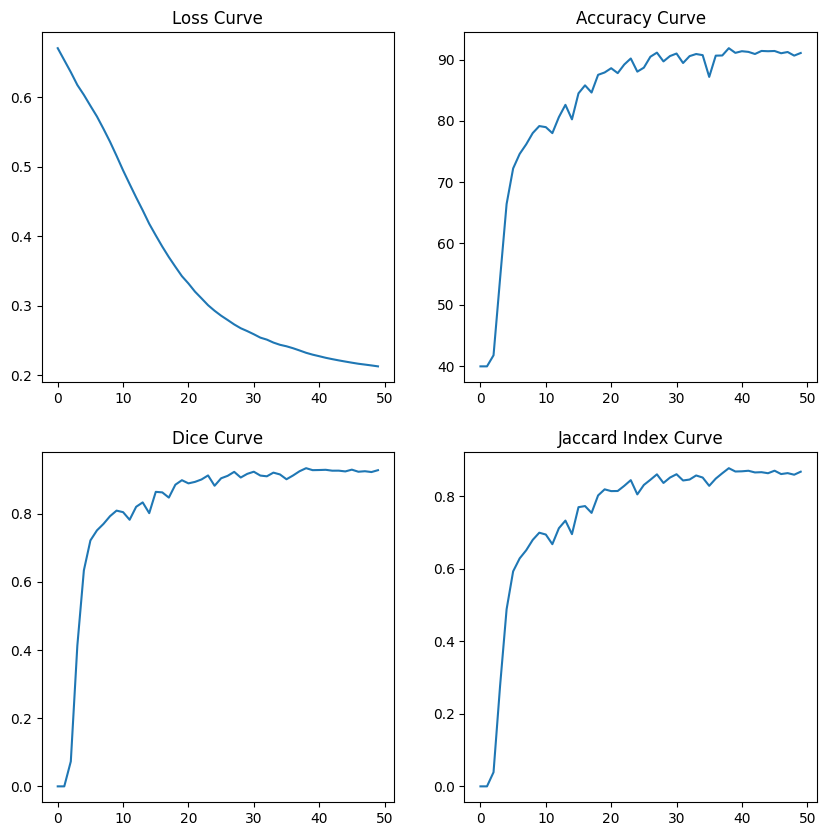

In [41]:
create_result_plot(df)

=> Loading checkpoint
(1, 256, 128)


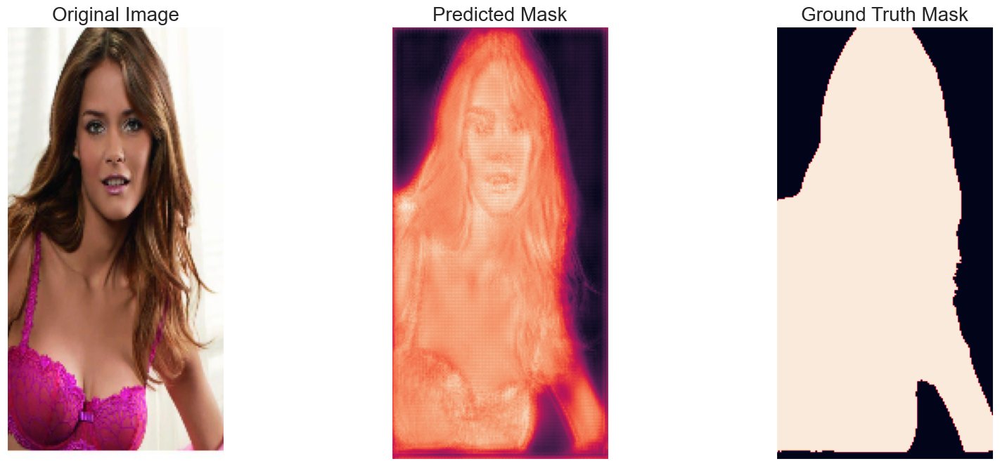

(1, 256, 128)


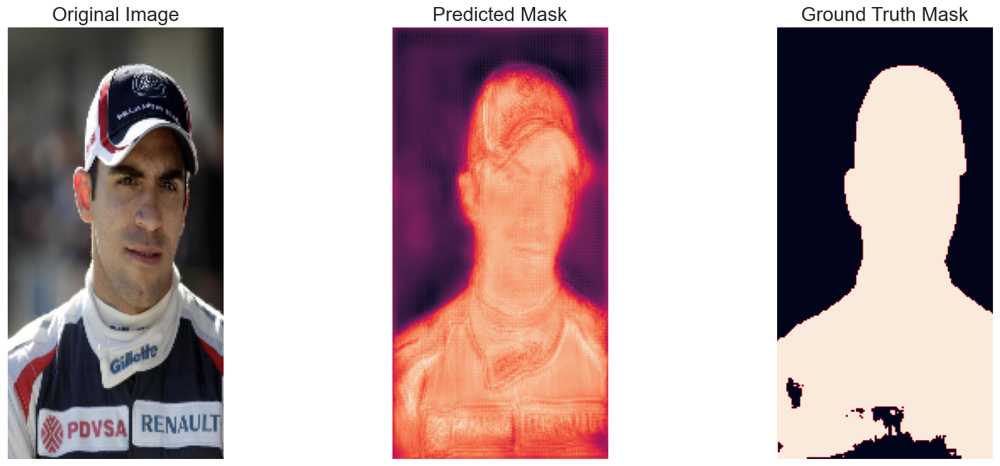

(1, 256, 128)


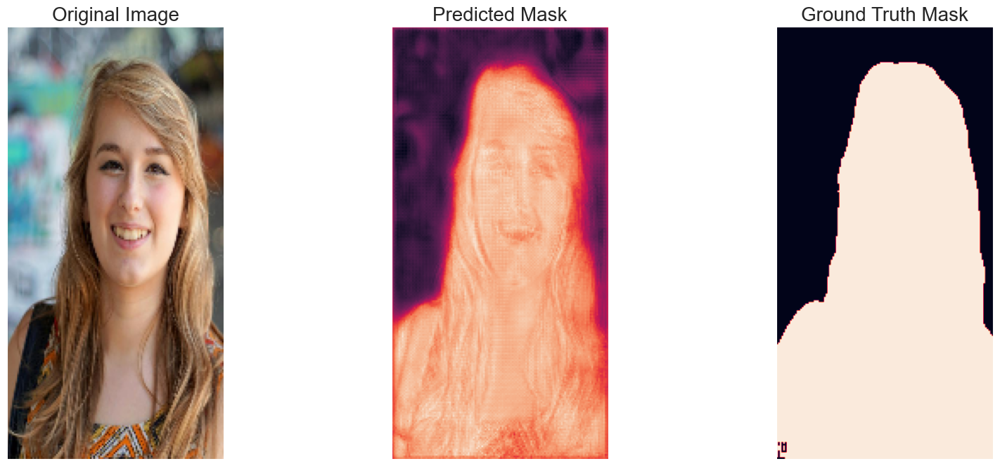

(1, 256, 128)


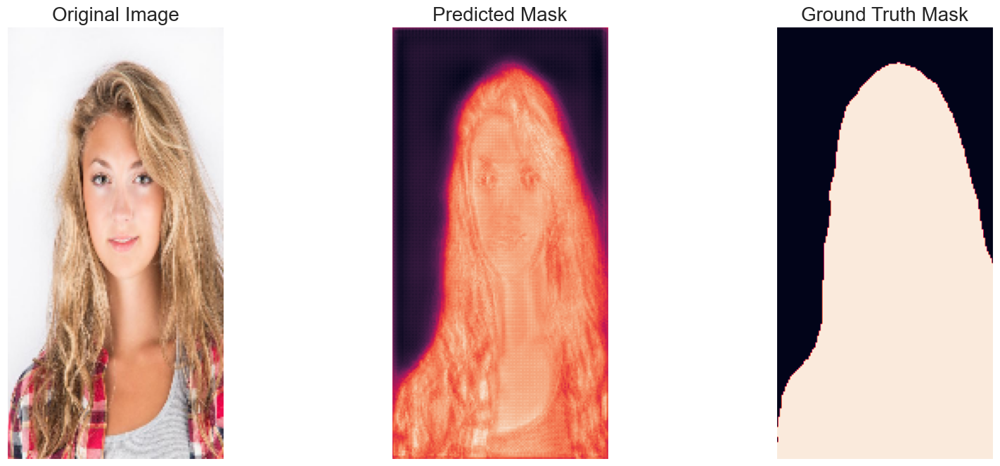

(1, 256, 128)


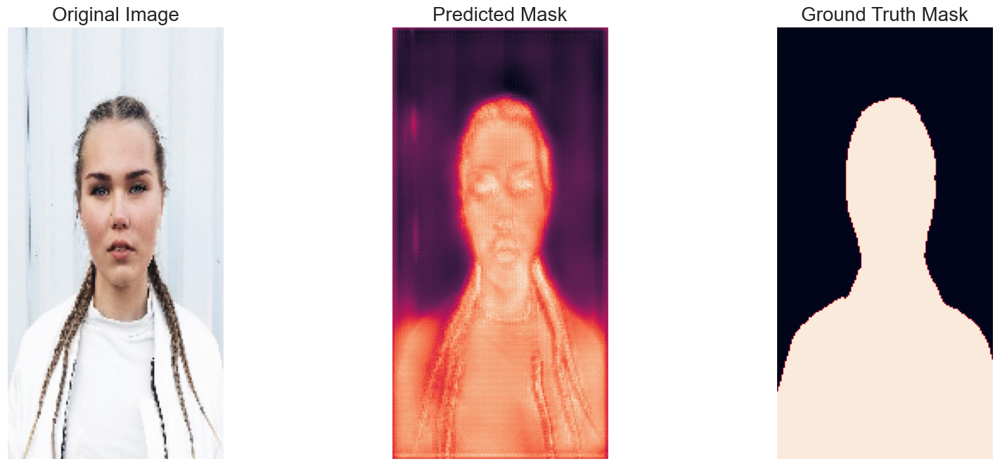

(1, 256, 128)


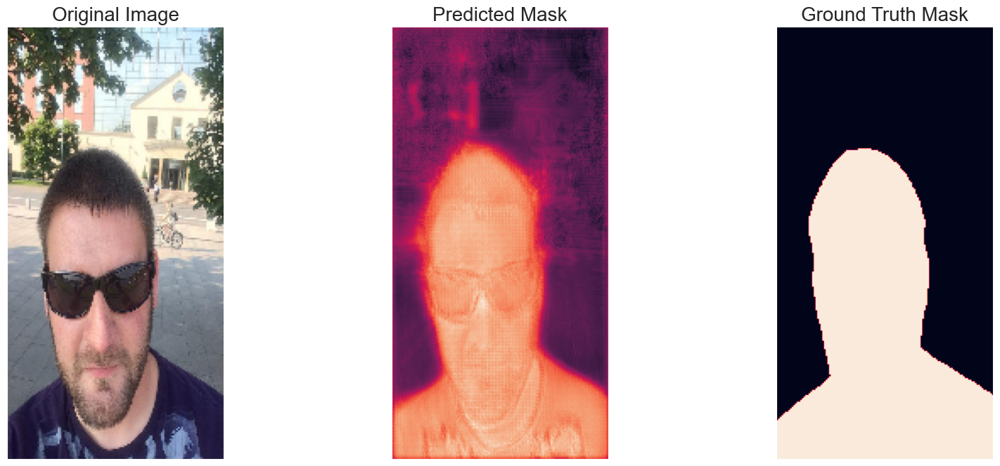

(1, 256, 128)


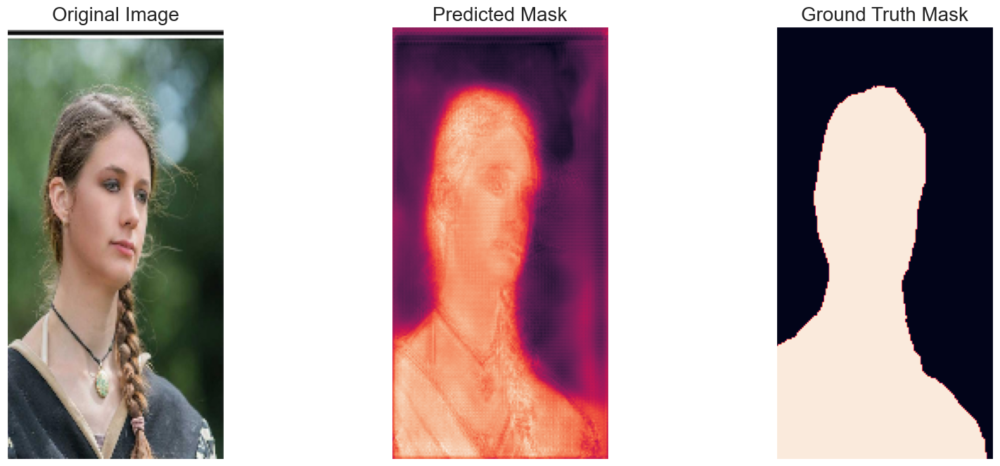

(1, 256, 128)


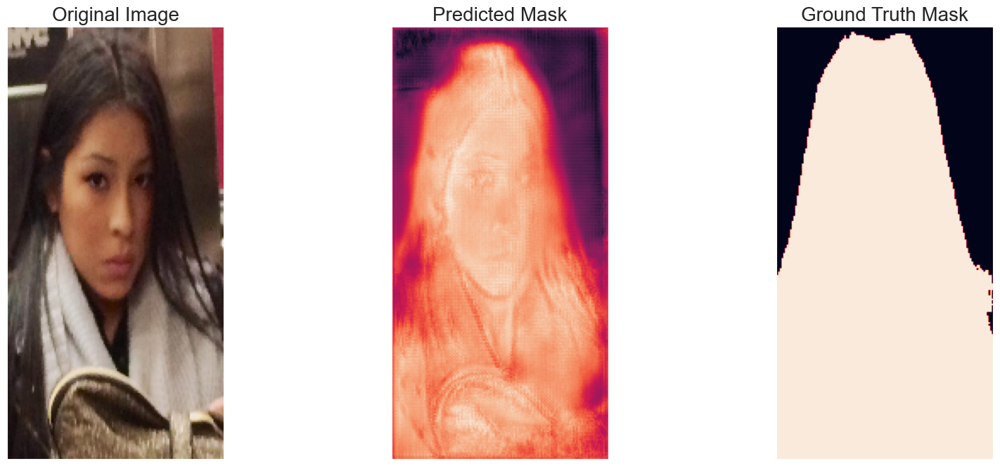

(1, 256, 128)


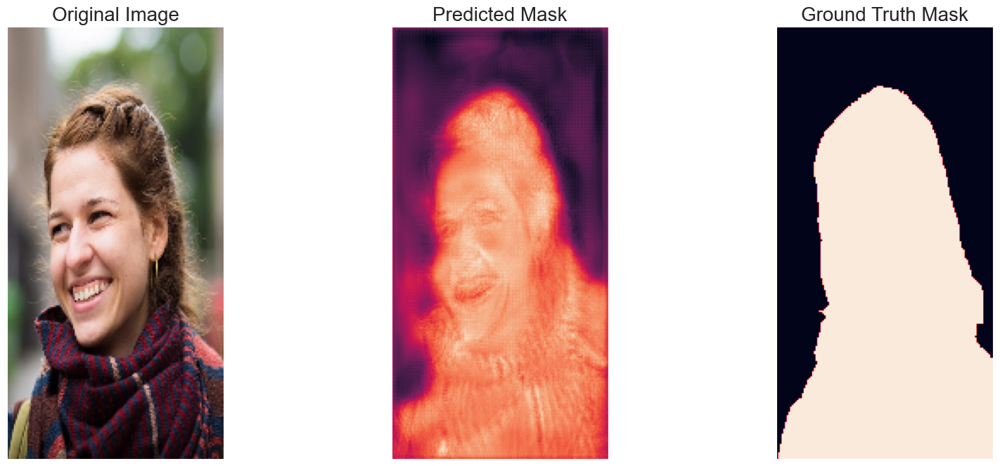

(1, 256, 128)


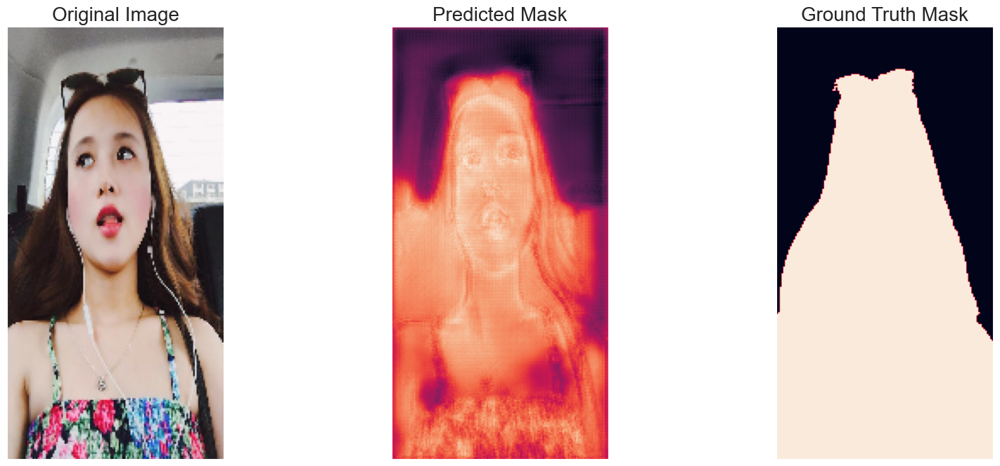

(1, 256, 128)


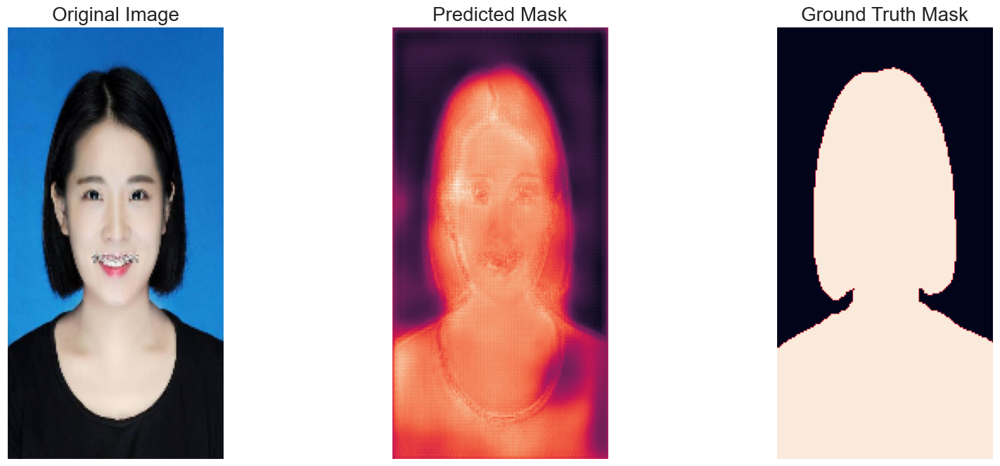

(1, 256, 128)


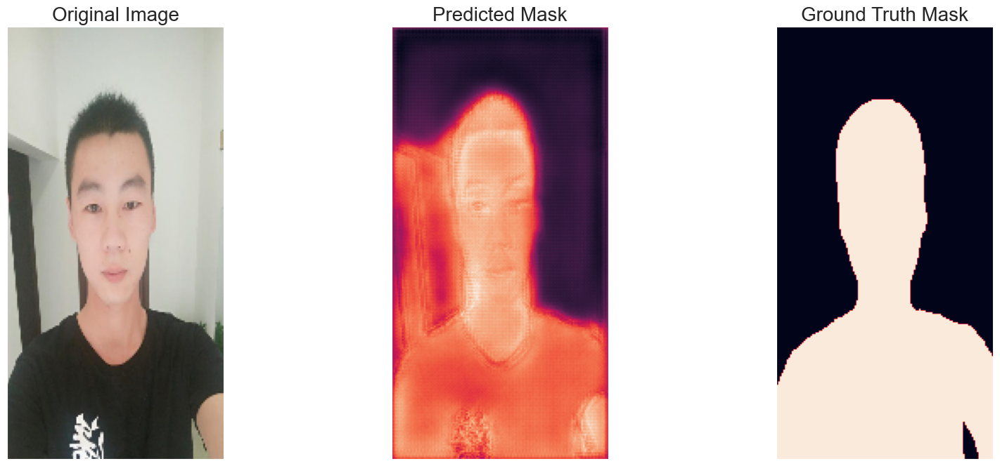

(1, 256, 128)


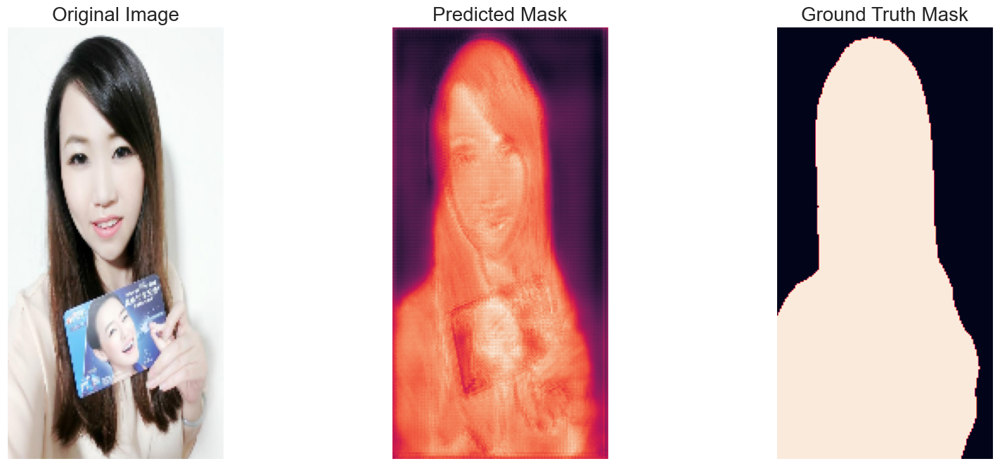

(1, 256, 128)


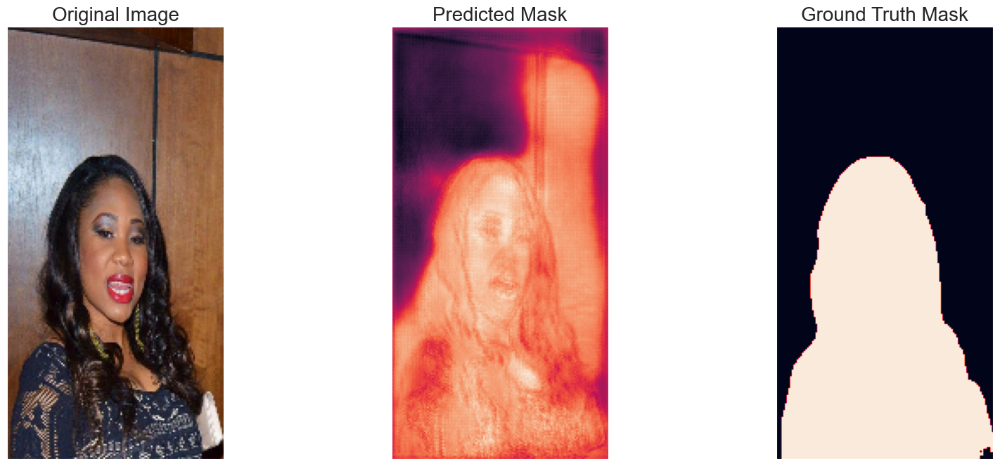

(1, 256, 128)


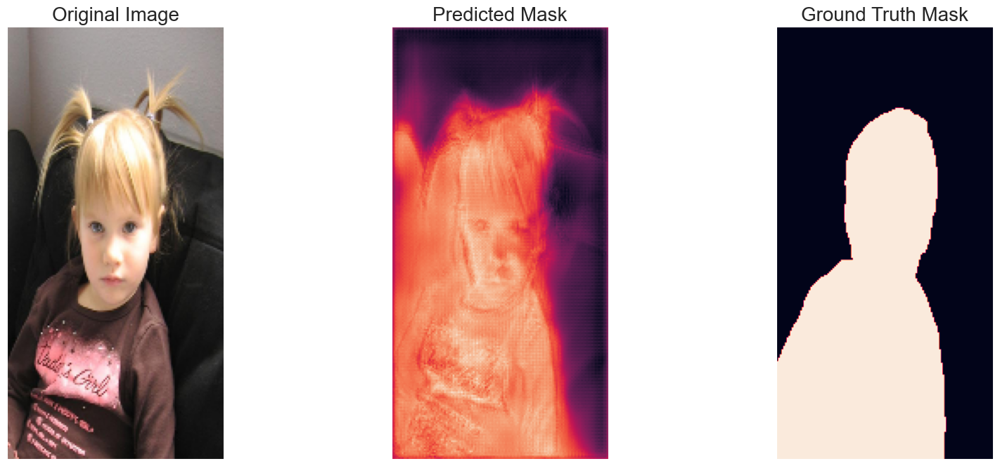

In [20]:
from hw.task3.dataset import SelfieDataset
from hw.task3.utils import load_checkpoint

best_model = None

# load best saved model checkpoint from the current run
if os.path.exists("overfitted/checkpoint.pth.tar"):
    best_model = UNET(in_channels=3, out_channels=1).to(DEVICE) # first_out_channels=64, exit_channels=1
    load_checkpoint(torch.load("overfitted/checkpoint.pth.tar"), best_model)

test_dataset = SelfieDataset(img_dir=TEST_IMG_PATH, mask_dir=TEST_MASK_PATH, transform=val_transforms)

for idx in range(min(len(test_dataset), 15)):

    image, gt_mask = test_dataset[idx]

    x_tensor = image.to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze(0).cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    print(pred_mask.shape)
    pred_mask = np.transpose(pred_mask,(1,2,0))

    # pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = gt_mask.unsqueeze(0)
    gt_mask = np.transpose(gt_mask,(1,2,0))
    image = np.transpose(image,(1,2,0))
    # gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
    # cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])
    
    visualize(
        original_image = image,
        predicted_mask = pred_mask,
        ground_truth_mask = gt_mask,
    )

In [45]:
trained_model = UNET(in_channels=3, out_channels=1).to(DEVICE) # first_out_channels=64, exit_channels=1
load_checkpoint(torch.load("overfitted/checkpoint.pth.tar"), trained_model)

accuracy, dice_score, jaccard_index_score = check_accuracy(overfit_loader, trained_model, device=DEVICE)
print(f"OVERFIT DATASET: {accuracy=}, {dice_score=}, {jaccard_index_score=}")

accuracy, dice_score, jaccard_index_score = check_accuracy(test_loader, trained_model, device=DEVICE)
print(f"TEST DATASET {accuracy=}, {dice_score=}, {jaccard_index_score=}")

=> Loading checkpoint
Got 881973/960000 with acc 91.87
Dice score: 0.933238685131073
Jaccard Index score: 0.8771113753318787
OVERFIT DATASET: accuracy=91.8721923828125, dice_score=0.933238685131073, jaccard_index_score=0.8771113753318787
Got 13468645/96480000 with acc 13.96
Dice score: 0.22517256438732147
Jaccard Index score: 0.12708048522472382
TEST DATASET accuracy=13.960038185119629, dice_score=0.22517256438732147, jaccard_index_score=0.12708048522472382


#### Result

Как мы можем заметить по графикам[img](overfitted/results.png) и результатам на одном батче(8 картинок), с увеличенным разрешением картинок, удалось обучиться до точности
- Got 881973/960000 with acc 91.87
- Dice score: 0.933238685131073
- Jaccard Index score: 0.8771113753318787 

без применения каких-либо методов аугментации и сжатия картинки. Однако на всем если брать тестовую выборку то получаются очень плохие результаты:
- Got 13468645/96480000 with acc 13.96
- Dice score: 0.22517256438732147
- Jaccard Index score: 0.12708048522472382

Пример предсказания:
- Исходная маска[link](overfitted/true.png)
- Предсказанная маска[link](overfitted/pred.png)

Перейдем к обучению на всем датасете.

## Full Train dataset

### Same params and same architecture

In [17]:
LEARNING_RATE = 1e-4
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
BATCH_SIZE = 16
NUM_EPOCHS = 20
NUM_WORKERS = os.cpu_count()
IMAGE_HEIGHT = 256
IMAGE_WIDTH = 128
PIN_MEMORY = True
LOAD_MODEL = False

In [18]:
train_transform = A.Compose(
    [
        A.Resize(height=IMAGE_HEIGHT, width=IMAGE_WIDTH),
        # A.Rotate(limit=35, p=1.0),
        # A.HorizontalFlip(p=0.5),
        # A.VerticalFlip(p=0.1),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

val_transforms = A.Compose(
    [
        A.Resize(height=IMAGE_HEIGHT, width=IMAGE_WIDTH),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

In [19]:
from hw.task3.utils import get_loaders, load_checkpoint, check_accuracy, save_checkpoint, save_predictions_as_imgs, get_single_loader

model = UNET(in_channels=3, out_channels=1).to(DEVICE) # first_out_channels=64, exit_channels=1
loss_fn = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

train_loader, val_loader, test_loader = get_loaders(
    TRAIN_IMG_PATH,
    TRAIN_MASK_PATH,
    VAL_IMG_PATH,
    VAL_MASK_PATH,
    TEST_MASK_PATH,
    TEST_MASK_PATH,
    BATCH_SIZE,
    train_transform,
    val_transforms,
    NUM_WORKERS,
    PIN_MEMORY,
)

In [20]:
pred_acc = check_accuracy(val_loader, model, device=DEVICE)[0]
scaler = torch.cuda.amp.GradScaler()

results = {'loss': [],
           'acc': [],
           'dice': [],
           'jaccard': []
           }

for epoch in range(NUM_EPOCHS):
    loss = train_fn(train_loader, model, optimizer, loss_fn, scaler)

    # check accuracy
    acc, dice, jacc = check_accuracy(val_loader, model, device=DEVICE)
    
    if acc > pred_acc:
        # save model
        checkpoint = {
            "state_dict": model.state_dict(),
            "optimizer":optimizer.state_dict(),
        }
        save_checkpoint(checkpoint, filename="simple_full_train/checkpoint.pth.tar")

        pred_acc = acc

        # print some examples to a folder
        save_predictions_as_imgs(
            val_loader, model, folder="saved_images/", device=DEVICE
        )
    
    results['loss'].append(loss)
    results['acc'].append(acc)
    results['dice'].append(dice)
    results['jaccard'].append(jacc)
    
    print(f"Epoch number: {epoch}")

Got 6682296/13074432 with acc 51.11
Dice score: 0.6757338643074036
Jaccard Index score: 0.511088490486145


100%|██████████| 88/88 [00:26<00:00,  3.30it/s, loss=0.217]


Got 12115203/13074432 with acc 92.66
Dice score: 0.926874041557312
Jaccard Index score: 0.8638946413993835
=> Saving checkpoint
Epoch number: 0


100%|██████████| 88/88 [00:20<00:00,  4.40it/s, loss=0.139]


Got 12314396/13074432 with acc 94.19
Dice score: 0.9449706077575684
Jaccard Index score: 0.8959285020828247
=> Saving checkpoint
Epoch number: 1


100%|██████████| 88/88 [00:20<00:00,  4.40it/s, loss=0.141]


Got 12353275/13074432 with acc 94.48
Dice score: 0.9452242255210876
Jaccard Index score: 0.8962963819503784
=> Saving checkpoint
Epoch number: 2


100%|██████████| 88/88 [00:21<00:00,  4.17it/s, loss=0.104] 


Got 12600241/13074432 with acc 96.37
Dice score: 0.9645383358001709
Jaccard Index score: 0.9316464066505432
=> Saving checkpoint
Epoch number: 3


100%|██████████| 88/88 [00:21<00:00,  4.06it/s, loss=0.111] 


Got 12639860/13074432 with acc 96.68
Dice score: 0.9677624106407166
Jaccard Index score: 0.9376564025878906
=> Saving checkpoint
Epoch number: 4


100%|██████████| 88/88 [00:21<00:00,  4.12it/s, loss=0.11]  


Got 12664252/13074432 with acc 96.86
Dice score: 0.9698134660720825
Jaccard Index score: 0.9414901733398438
=> Saving checkpoint
Epoch number: 5


100%|██████████| 88/88 [00:22<00:00,  3.99it/s, loss=0.0559]


Got 12706979/13074432 with acc 97.19
Dice score: 0.9727566242218018
Jaccard Index score: 0.9470120072364807
=> Saving checkpoint
Epoch number: 6


100%|██████████| 88/88 [00:21<00:00,  4.13it/s, loss=0.0625]


Got 12702354/13074432 with acc 97.15
Dice score: 0.9722132086753845
Jaccard Index score: 0.9459987282752991
Epoch number: 7


100%|██████████| 88/88 [00:23<00:00,  3.76it/s, loss=0.0409]


Got 12737752/13074432 with acc 97.42
Dice score: 0.9748923778533936
Jaccard Index score: 0.951085090637207
=> Saving checkpoint
Epoch number: 8


100%|██████████| 88/88 [00:23<00:00,  3.72it/s, loss=0.0374]


Got 12758137/13074432 with acc 97.58
Dice score: 0.9763672351837158
Jaccard Index score: 0.9538702964782715
=> Saving checkpoint
Epoch number: 9


100%|██████████| 88/88 [00:23<00:00,  3.81it/s, loss=0.0674]


Got 12644792/13074432 with acc 96.71
Dice score: 0.9681972861289978
Jaccard Index score: 0.9384819865226746
Epoch number: 10


100%|██████████| 88/88 [00:21<00:00,  4.06it/s, loss=0.0411]


Got 12757830/13074432 with acc 97.58
Dice score: 0.9764427542686462
Jaccard Index score: 0.9540446400642395
Epoch number: 11


100%|██████████| 88/88 [00:21<00:00,  4.06it/s, loss=0.0319]


Got 12778012/13074432 with acc 97.73
Dice score: 0.9779723286628723
Jaccard Index score: 0.9569653868675232
=> Saving checkpoint
Epoch number: 12


100%|██████████| 88/88 [00:21<00:00,  4.05it/s, loss=0.0298]


Got 12769281/13074432 with acc 97.67
Dice score: 0.9773061871528625
Jaccard Index score: 0.9556951522827148
Epoch number: 13


100%|██████████| 88/88 [00:26<00:00,  3.35it/s, loss=0.0282]


Got 12770641/13074432 with acc 97.68
Dice score: 0.9775123596191406
Jaccard Index score: 0.9560865759849548
Epoch number: 14


100%|██████████| 88/88 [00:22<00:00,  3.90it/s, loss=0.0288]


Got 12745873/13074432 with acc 97.49
Dice score: 0.9757047295570374
Jaccard Index score: 0.9526507258415222
Epoch number: 15


100%|██████████| 88/88 [00:25<00:00,  3.51it/s, loss=0.0514]


Got 12813195/13074432 with acc 98.00
Dice score: 0.9805737137794495
Jaccard Index score: 0.9619405269622803
=> Saving checkpoint
Epoch number: 16


100%|██████████| 88/88 [00:22<00:00,  3.98it/s, loss=0.0212]


Got 12829680/13074432 with acc 98.13
Dice score: 0.981856107711792
Jaccard Index score: 0.9644010663032532
=> Saving checkpoint
Epoch number: 17


100%|██████████| 88/88 [00:21<00:00,  4.08it/s, loss=0.0197]


Got 12813346/13074432 with acc 98.00
Dice score: 0.9807416796684265
Jaccard Index score: 0.9622799754142761
Epoch number: 18


100%|██████████| 88/88 [00:22<00:00,  3.88it/s, loss=0.0222]


Got 12826864/13074432 with acc 98.11
Dice score: 0.9816633462905884
Jaccard Index score: 0.9640334844589233
Epoch number: 19


In [21]:
DEVICE

device(type='cuda')

In [22]:
import pandas as pd
df = pd.DataFrame(results)

In [23]:
df

,loss,acc,dice,jaccard
0,0.353379,92.663322,0.926874,0.863895
1,0.192915,94.186852,0.944971,0.895929
2,0.149995,94.484215,0.945224,0.896296
3,0.122021,96.373138,0.964538,0.931646
4,0.102147,96.676170,0.967762,0.937656
5,0.083443,96.862732,0.969813,0.941490
6,0.072699,97.189529,0.972757,0.947012
7,0.066938,97.154152,0.972213,0.945999
8,0.052240,97.424896,0.974892,0.951085
9,0.045425,97.580811,0.976367,0.953870


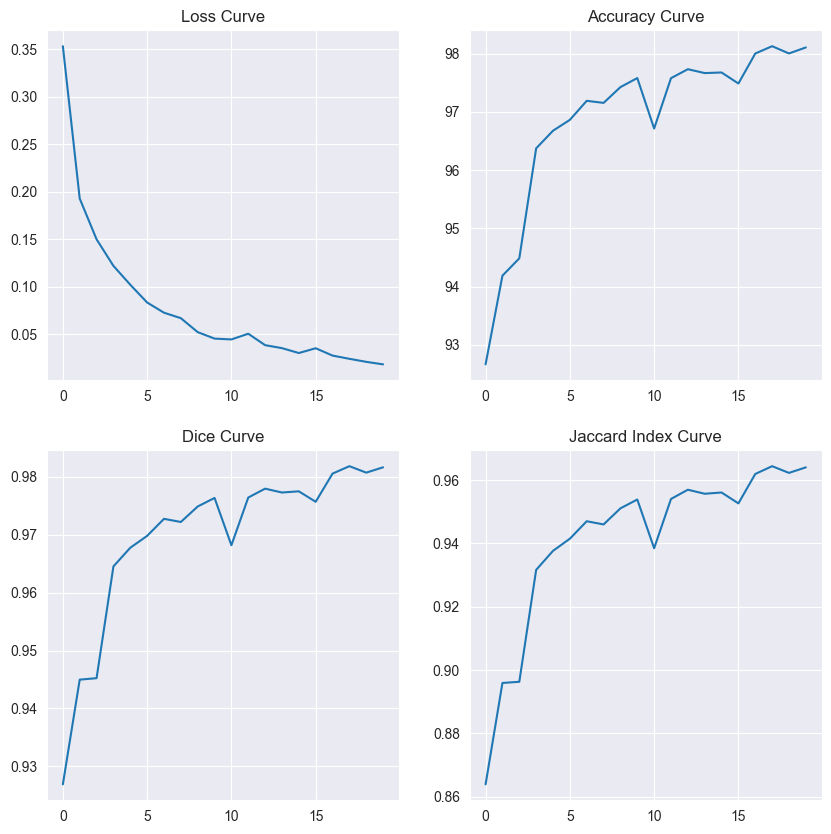

In [24]:
create_result_plot(df)

=> Loading checkpoint
(1, 256, 128)


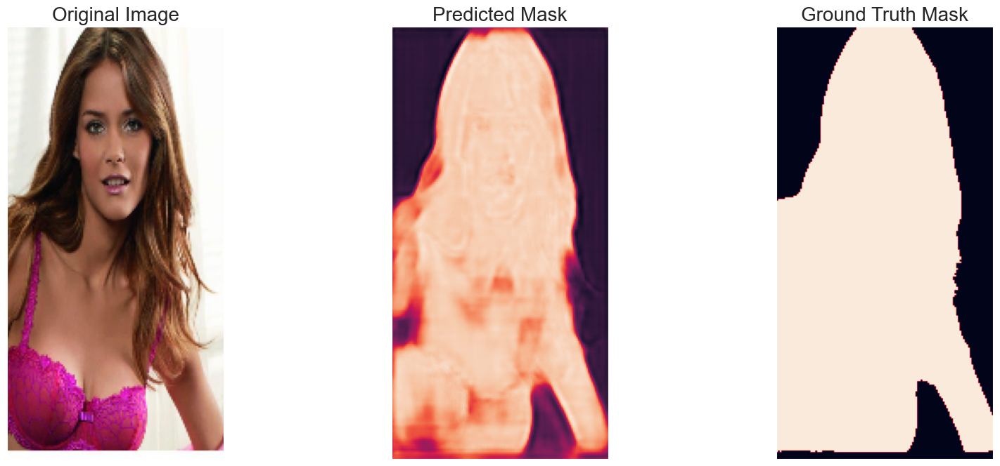

(1, 256, 128)


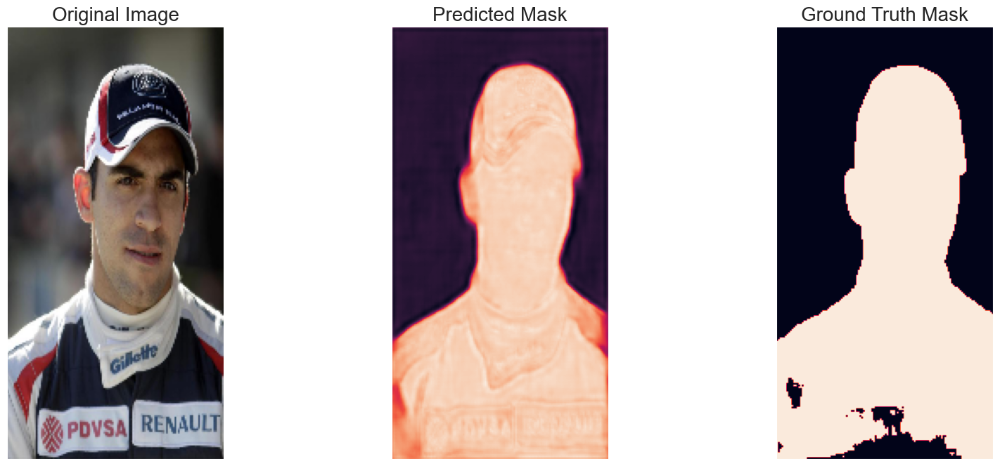

(1, 256, 128)


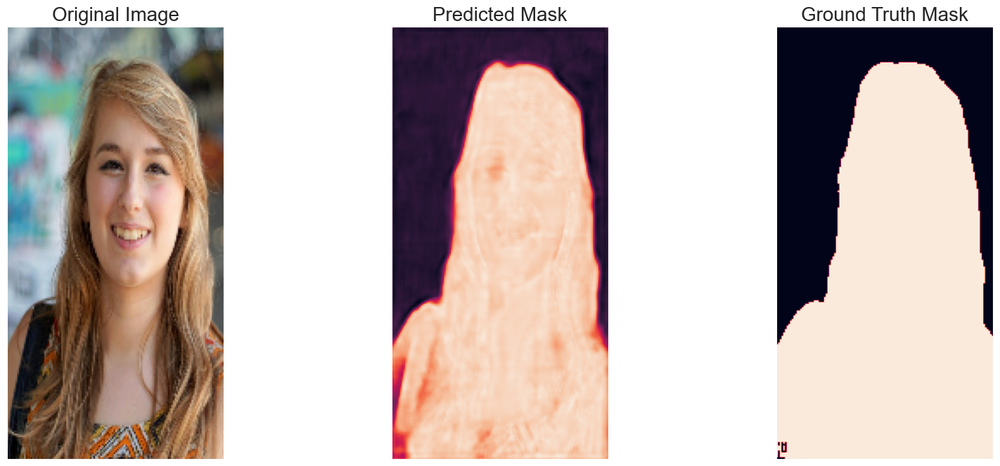

(1, 256, 128)


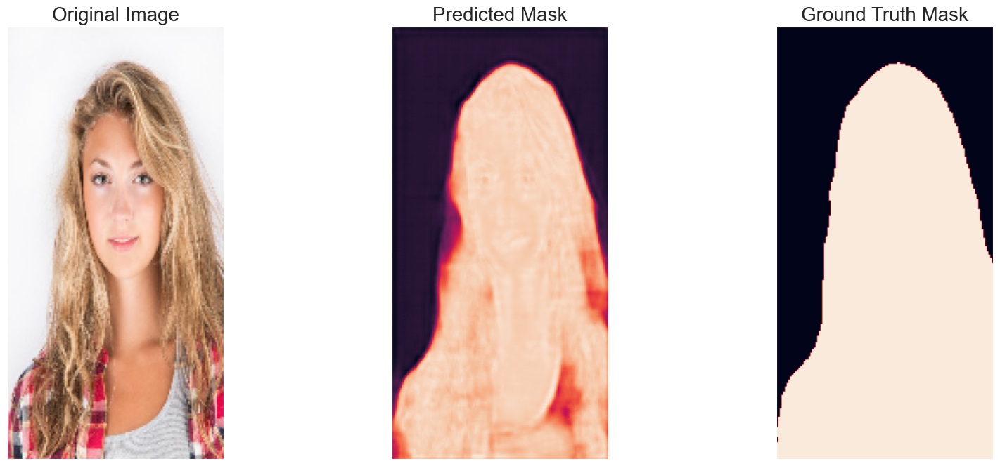

(1, 256, 128)


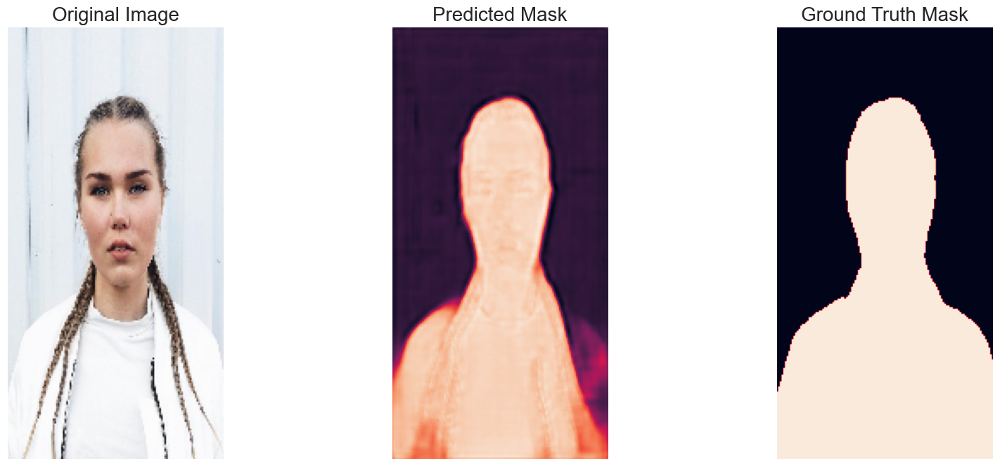

(1, 256, 128)


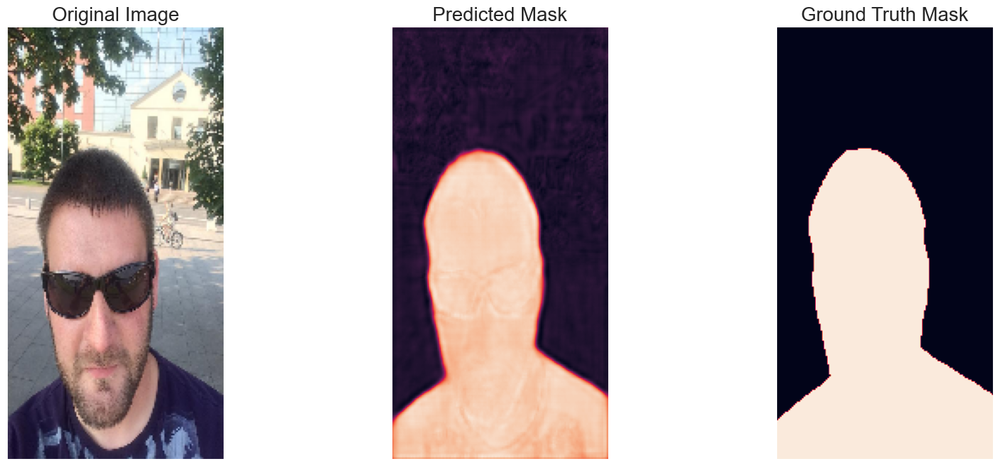

(1, 256, 128)


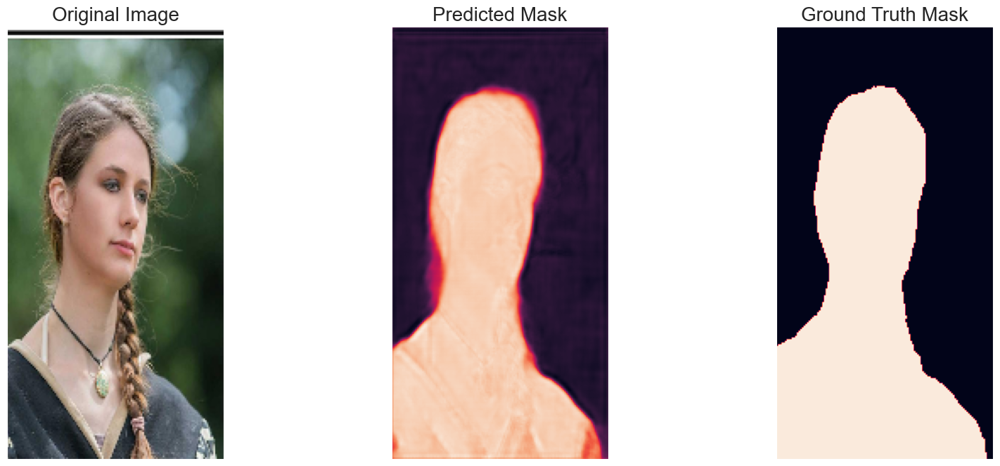

(1, 256, 128)


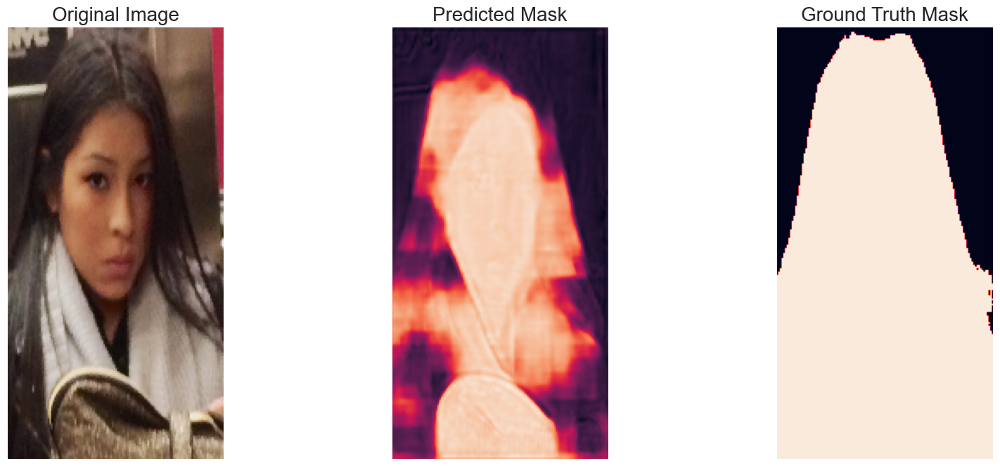

(1, 256, 128)


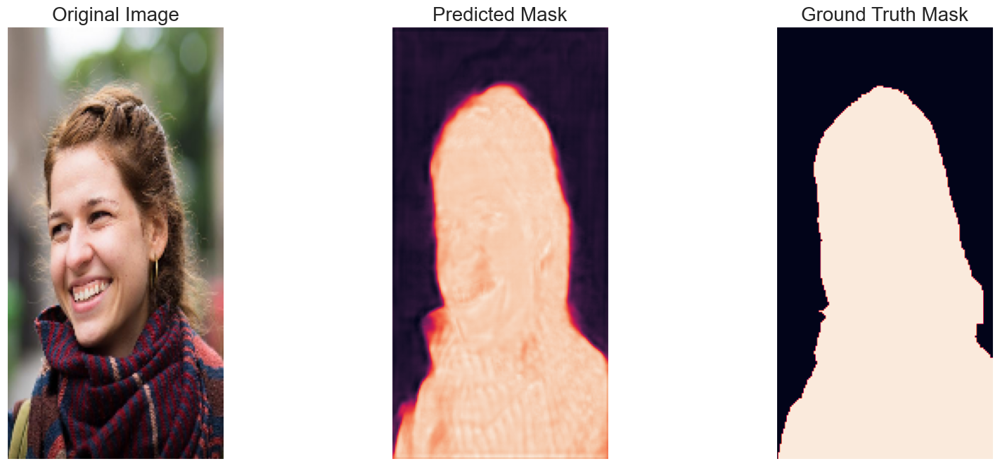

(1, 256, 128)


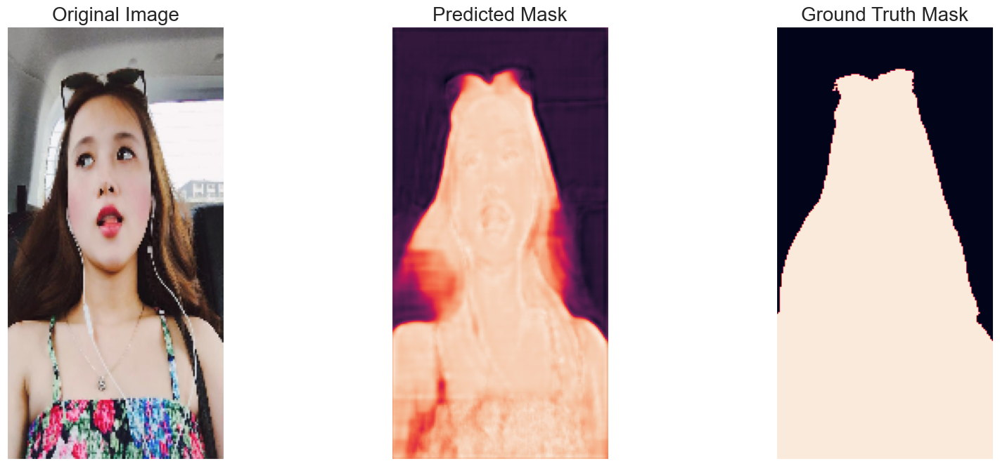

(1, 256, 128)


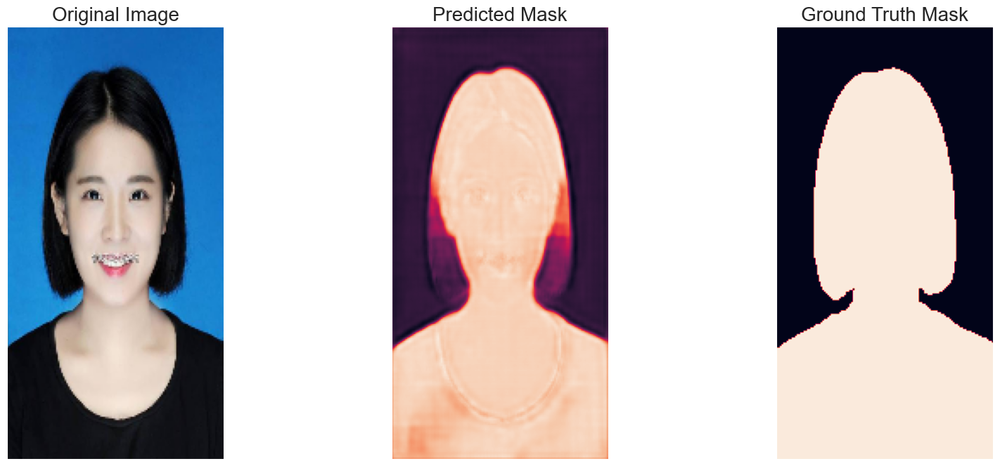

(1, 256, 128)


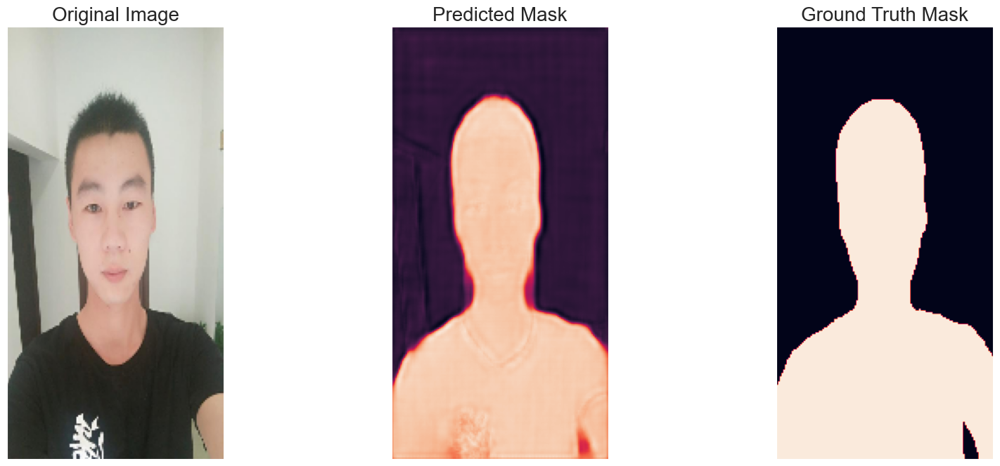

(1, 256, 128)


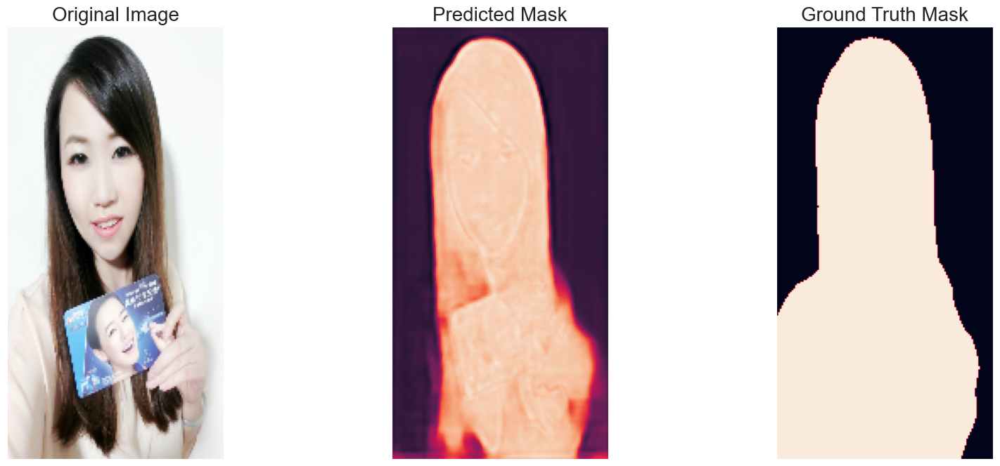

(1, 256, 128)


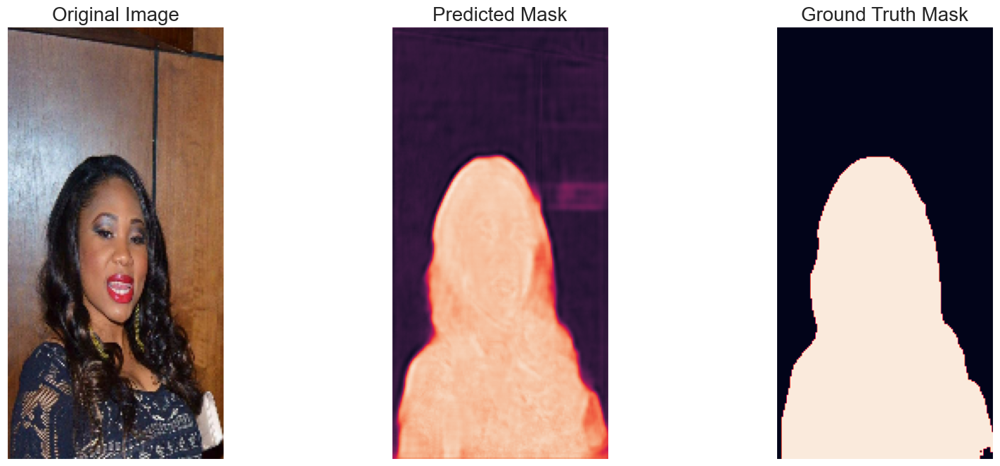

(1, 256, 128)


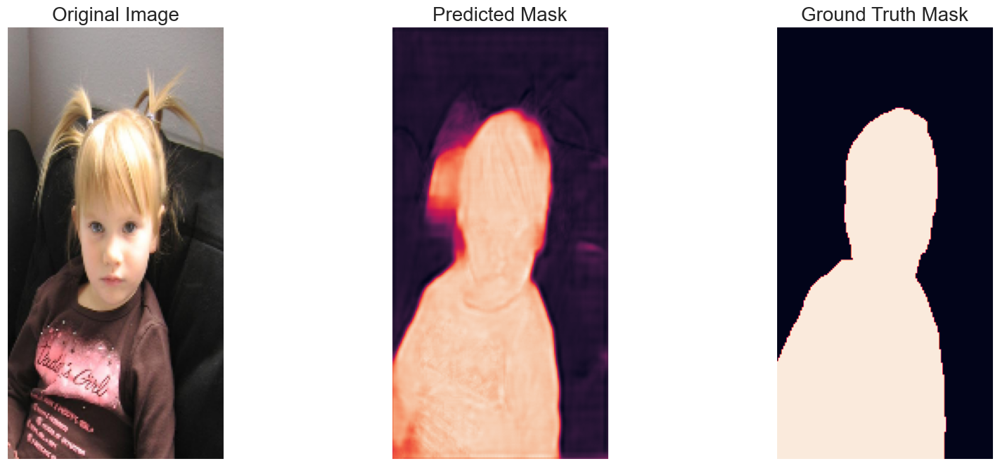

In [19]:
from hw.task3.dataset import SelfieDataset
from hw.task3.utils import load_checkpoint

best_model = None

# load best saved model checkpoint from the current run
if os.path.exists("simple_full_train/checkpoint.pth.tar"):
    best_model = UNET(in_channels=3, out_channels=1).to(DEVICE) # first_out_channels=64, exit_channels=1
    load_checkpoint(torch.load("simple_full_train/checkpoint.pth.tar"), best_model)

test_dataset = SelfieDataset(img_dir=TEST_IMG_PATH, mask_dir=TEST_MASK_PATH, transform=val_transforms)

for idx in range(min(len(test_dataset), 15)):

    image, gt_mask = test_dataset[idx]

    x_tensor = image.to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze(0).cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    print(pred_mask.shape)
    pred_mask = np.transpose(pred_mask,(1,2,0))

    # pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = gt_mask.unsqueeze(0)
    gt_mask = np.transpose(gt_mask,(1,2,0))
    image = np.transpose(image,(1,2,0))
    # gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
    # cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])
    
    visualize(
        original_image = image,
        predicted_mask = pred_mask,
        ground_truth_mask = gt_mask,
    )

In [25]:
trained_model = UNET(in_channels=3, out_channels=1).to(DEVICE) # first_out_channels=64, exit_channels=1
load_checkpoint(torch.load("simple_full_train/checkpoint.pth.tar"), trained_model)

accuracy, dice_score, jaccard_index_score = check_accuracy(val_loader, trained_model, device=DEVICE)
print(f"VAL DATASET: {accuracy=}, {dice_score=}, {jaccard_index_score=}")

accuracy, dice_score, jaccard_index_score = check_accuracy(test_loader, trained_model, device=DEVICE)
print(f"TEST DATASET {accuracy=}, {dice_score=}, {jaccard_index_score=}")

=> Loading checkpoint
Got 12829680/13074432 with acc 98.13
Dice score: 0.981856107711792
Jaccard Index score: 0.9644010663032532
VAL DATASET: accuracy=98.12800598144531, dice_score=0.981856107711792, jaccard_index_score=0.9644010663032532
Got 6465686/6586368 with acc 98.17
Dice score: 0.9818514585494995
Jaccard Index score: 0.9646093845367432
TEST DATASET accuracy=98.1677017211914, dice_score=0.9818514585494995, jaccard_index_score=0.9646093845367432


#### Result

Как мы можем заметить по графикам([img](simple_full_train/results.png)), на полном train датасете удалось обучиться до точности(на val dataset)
- Got 12829680/13074432 with acc 98.13
- Dice score: 0.981856107711792
- Jaccard Index score: 0.9644010663032532

без применения каких-либо методов аугментации и сжатия картинки. Если же брать тестовую выборку, то получаются уже довольно хорошие результаты:
- Got 6465686/6586368 with acc 98.17
- Dice score: 0.9818514585494995
- Jaccard Index score: 0.9646093845367432

Пример предсказания:
- Исходная маска([link](simple_full_train/true.png))
- Предсказанная маска([link](simple_full_train/pred.png))

Перейдем к обучению на всем датасете с применением различных методов аугметации, чтобы попытаться улучшить результат.

### Same architecture and img transformations

In [8]:
LEARNING_RATE = 1e-4
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
BATCH_SIZE = 16
NUM_EPOCHS = 20
NUM_WORKERS = os.cpu_count()
IMAGE_HEIGHT = 256
IMAGE_WIDTH = 128
PIN_MEMORY = True
LOAD_MODEL = False

In [9]:
train_transform = A.Compose(
    [
        A.Resize(height=IMAGE_HEIGHT, width=IMAGE_WIDTH),
        A.Rotate(limit=35, p=1.0),
        A.HorizontalFlip(p=0.5),
        A.VerticalFlip(p=0.1),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

val_transforms = A.Compose(
    [
        A.Resize(height=IMAGE_HEIGHT, width=IMAGE_WIDTH),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

In [14]:
from hw.task3.utils import get_loaders, load_checkpoint, check_accuracy, save_checkpoint, save_predictions_as_imgs, get_single_loader

model = UNET(in_channels=3, out_channels=1).to(DEVICE) # first_out_channels=64, exit_channels=1
loss_fn = nn.BCEWithLogitsLoss()
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

train_loader, val_loader, test_loader = get_loaders(
    TRAIN_IMG_PATH,
    TRAIN_MASK_PATH,
    VAL_IMG_PATH,
    VAL_MASK_PATH,
    TEST_MASK_PATH,
    TEST_MASK_PATH,
    BATCH_SIZE,
    train_transform,
    val_transforms,
    NUM_WORKERS,
    PIN_MEMORY,
)

In [15]:
pred_acc = check_accuracy(val_loader, model, device=DEVICE)[0]
scaler = torch.cuda.amp.GradScaler()

results = {'loss': [],
           'acc': [],
           'dice': [],
           'jaccard': []
           }

for epoch in range(NUM_EPOCHS):
    loss = train_fn(train_loader, model, optimizer, loss_fn, scaler)

    # check accuracy
    acc, dice, jacc = check_accuracy(val_loader, model, device=DEVICE)
    
    if acc > pred_acc:
        # save model
        checkpoint = {
            "state_dict": model.state_dict(),
            "optimizer":optimizer.state_dict(),
        }
        save_checkpoint(checkpoint, filename="aug_full_train/checkpointV4.pth.tar")

        pred_acc = acc

        # print some examples to a folder
        save_predictions_as_imgs(
            val_loader, model, folder="saved_images/", device=DEVICE
        )
    
    results['loss'].append(loss)
    results['acc'].append(acc)
    results['dice'].append(dice)
    results['jaccard'].append(jacc)
    
    print(f"Epoch number: {epoch}")

Got 6682296/13074432 with acc 51.11
Dice score: 0.6757338643074036
Jaccard Index score: 0.511088490486145


100%|██████████| 88/88 [00:25<00:00,  3.44it/s, loss=0.49] 


Got 11502059/13074432 with acc 87.97
Dice score: 0.8768566846847534
Jaccard Index score: 0.7816435694694519
=> Saving checkpoint
Epoch number: 0


100%|██████████| 88/88 [00:20<00:00,  4.33it/s, loss=0.433]


Got 11739231/13074432 with acc 89.79
Dice score: 0.9032562971115112
Jaccard Index score: 0.8241924047470093
=> Saving checkpoint
Epoch number: 1


100%|██████████| 88/88 [00:21<00:00,  4.18it/s, loss=0.303]


Got 11827733/13074432 with acc 90.46
Dice score: 0.9118694067001343
Jaccard Index score: 0.8385525345802307
=> Saving checkpoint
Epoch number: 2


100%|██████████| 88/88 [00:21<00:00,  4.15it/s, loss=0.418]


Got 12206824/13074432 with acc 93.36
Dice score: 0.935147762298584
Jaccard Index score: 0.8783719539642334
=> Saving checkpoint
Epoch number: 3


100%|██████████| 88/88 [00:21<00:00,  4.13it/s, loss=0.241]


Got 11920120/13074432 with acc 91.17
Dice score: 0.9183166027069092
Jaccard Index score: 0.8494517803192139
Epoch number: 4


100%|██████████| 88/88 [00:21<00:00,  4.18it/s, loss=0.252]


Got 12231760/13074432 with acc 93.55
Dice score: 0.9380457997322083
Jaccard Index score: 0.8835815191268921
=> Saving checkpoint
Epoch number: 5


100%|██████████| 88/88 [00:21<00:00,  4.13it/s, loss=0.191]


Got 12341876/13074432 with acc 94.40
Dice score: 0.9468863606452942
Jaccard Index score: 0.899384081363678
=> Saving checkpoint
Epoch number: 6


100%|██████████| 88/88 [00:21<00:00,  4.12it/s, loss=0.249]


Got 12275872/13074432 with acc 93.89
Dice score: 0.9401594400405884
Jaccard Index score: 0.8873492479324341
Epoch number: 7


100%|██████████| 88/88 [00:21<00:00,  4.16it/s, loss=0.144]


Got 12311195/13074432 with acc 94.16
Dice score: 0.9448593854904175
Jaccard Index score: 0.8957476615905762
Epoch number: 8


100%|██████████| 88/88 [00:21<00:00,  4.08it/s, loss=0.133] 


Got 12528148/13074432 with acc 95.82
Dice score: 0.9596918225288391
Jaccard Index score: 0.922709584236145
=> Saving checkpoint
Epoch number: 9


100%|██████████| 88/88 [00:20<00:00,  4.20it/s, loss=0.137]


Got 12213841/13074432 with acc 93.42
Dice score: 0.9371640086174011
Jaccard Index score: 0.8822987079620361
Epoch number: 10


100%|██████████| 88/88 [00:21<00:00,  4.15it/s, loss=0.157] 


Got 12443757/13074432 with acc 95.18
Dice score: 0.952708899974823
Jaccard Index score: 0.9099246263504028
Epoch number: 11


100%|██████████| 88/88 [00:21<00:00,  4.16it/s, loss=0.118] 


Got 12455705/13074432 with acc 95.27
Dice score: 0.9553207159042358
Jaccard Index score: 0.9147436022758484
Epoch number: 12


100%|██████████| 88/88 [00:21<00:00,  4.16it/s, loss=0.162] 


Got 12539633/13074432 with acc 95.91
Dice score: 0.9609135389328003
Jaccard Index score: 0.9249733686447144
=> Saving checkpoint
Epoch number: 13


100%|██████████| 88/88 [00:22<00:00,  3.83it/s, loss=0.0902]


Got 12635636/13074432 with acc 96.64
Dice score: 0.9672610759735107
Jaccard Index score: 0.9367184042930603
=> Saving checkpoint
Epoch number: 14


100%|██████████| 88/88 [00:21<00:00,  4.15it/s, loss=0.183] 


Got 12533528/13074432 with acc 95.86
Dice score: 0.9604350328445435
Jaccard Index score: 0.9240527749061584
Epoch number: 15


100%|██████████| 88/88 [00:20<00:00,  4.19it/s, loss=0.0709]


Got 12645508/13074432 with acc 96.72
Dice score: 0.9683409929275513
Jaccard Index score: 0.9387160539627075
=> Saving checkpoint
Epoch number: 16


100%|██████████| 88/88 [00:21<00:00,  4.18it/s, loss=0.111] 


Got 12511881/13074432 with acc 95.70
Dice score: 0.958872377872467
Jaccard Index score: 0.9212205410003662
Epoch number: 17


100%|██████████| 88/88 [00:21<00:00,  4.15it/s, loss=0.112] 


Got 12636482/13074432 with acc 96.65
Dice score: 0.9677655696868896
Jaccard Index score: 0.9377195239067078
Epoch number: 18


100%|██████████| 88/88 [00:21<00:00,  4.13it/s, loss=0.0673]


Got 12565897/13074432 with acc 96.11
Dice score: 0.9623174071311951
Jaccard Index score: 0.927519679069519
Epoch number: 19


In [21]:
LEARNING_RATE = 1e-5
NUM_EPOCHS = 10
optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE)

for epoch in range(NUM_EPOCHS):
    loss = train_fn(train_loader, model, optimizer, loss_fn, scaler)

    # check accuracy
    acc, dice, jacc = check_accuracy(val_loader, model, device=DEVICE)

    if acc > pred_acc:
        # save model
        checkpoint = {
            "state_dict": model.state_dict(),
            "optimizer":optimizer.state_dict(),
        }
        save_checkpoint(checkpoint, filename="aug_full_train/checkpointV4-ft.pth.tar")

        pred_acc = acc

        # print some examples to a folder
        save_predictions_as_imgs(
            val_loader, model, folder="saved_images/", device=DEVICE
        )

    results['loss'].append(loss)
    results['acc'].append(acc)
    results['dice'].append(dice)
    results['jaccard'].append(jacc)

    print(f"Epoch number: {epoch}")

100%|██████████| 88/88 [00:21<00:00,  4.18it/s, loss=0.0718]


Got 12684779/13074432 with acc 97.02
Dice score: 0.9711655378341675
Jaccard Index score: 0.944049596786499
Epoch number: 0


100%|██████████| 88/88 [00:20<00:00,  4.35it/s, loss=0.0413]


Got 12701497/13074432 with acc 97.15
Dice score: 0.9723040461540222
Jaccard Index score: 0.9461935758590698
Epoch number: 1


100%|██████████| 88/88 [00:21<00:00,  4.17it/s, loss=0.164] 


Got 12678036/13074432 with acc 96.97
Dice score: 0.9706332683563232
Jaccard Index score: 0.9430558681488037
Epoch number: 2


100%|██████████| 88/88 [00:21<00:00,  4.15it/s, loss=0.0746]


Got 12694916/13074432 with acc 97.10
Dice score: 0.9717879891395569
Jaccard Index score: 0.9452142715454102
Epoch number: 3


100%|██████████| 88/88 [00:21<00:00,  4.12it/s, loss=0.0545]


Got 12682442/13074432 with acc 97.00
Dice score: 0.970954418182373
Jaccard Index score: 0.9436624050140381
Epoch number: 4


100%|██████████| 88/88 [00:21<00:00,  4.18it/s, loss=0.0417]


Got 12690215/13074432 with acc 97.06
Dice score: 0.9715072512626648
Jaccard Index score: 0.9447039365768433
Epoch number: 5


100%|██████████| 88/88 [00:21<00:00,  4.19it/s, loss=0.1]   


Got 12696082/13074432 with acc 97.11
Dice score: 0.9719290733337402
Jaccard Index score: 0.9454708695411682
Epoch number: 6


100%|██████████| 88/88 [00:21<00:00,  4.18it/s, loss=0.0309]


Got 12692861/13074432 with acc 97.08
Dice score: 0.9717080593109131
Jaccard Index score: 0.9450755715370178
Epoch number: 7


100%|██████████| 88/88 [00:20<00:00,  4.20it/s, loss=0.0468]


Got 12684015/13074432 with acc 97.01
Dice score: 0.9709873795509338
Jaccard Index score: 0.943714439868927
Epoch number: 8


100%|██████████| 88/88 [00:20<00:00,  4.20it/s, loss=0.0538]


Got 12701870/13074432 with acc 97.15
Dice score: 0.9723313450813293
Jaccard Index score: 0.9462510347366333
Epoch number: 9


In [14]:
DEVICE

device(type='cuda')

In [22]:
import pandas as pd
df = pd.DataFrame(results)

In [23]:
df

,loss,acc,dice,jaccard
0,0.462723,87.973679,0.876857,0.781644
1,0.358464,89.787689,0.903256,0.824192
2,0.308888,90.464607,0.911869,0.838553
3,0.272118,93.364082,0.935148,0.878372
4,0.247749,91.171227,0.918317,0.849452
5,0.223283,93.554810,0.938046,0.883582
6,0.206670,94.397034,0.946886,0.899384
7,0.191647,93.892197,0.940159,0.887349
8,0.178195,94.162369,0.944859,0.895748
9,0.162250,95.821739,0.959692,0.922710


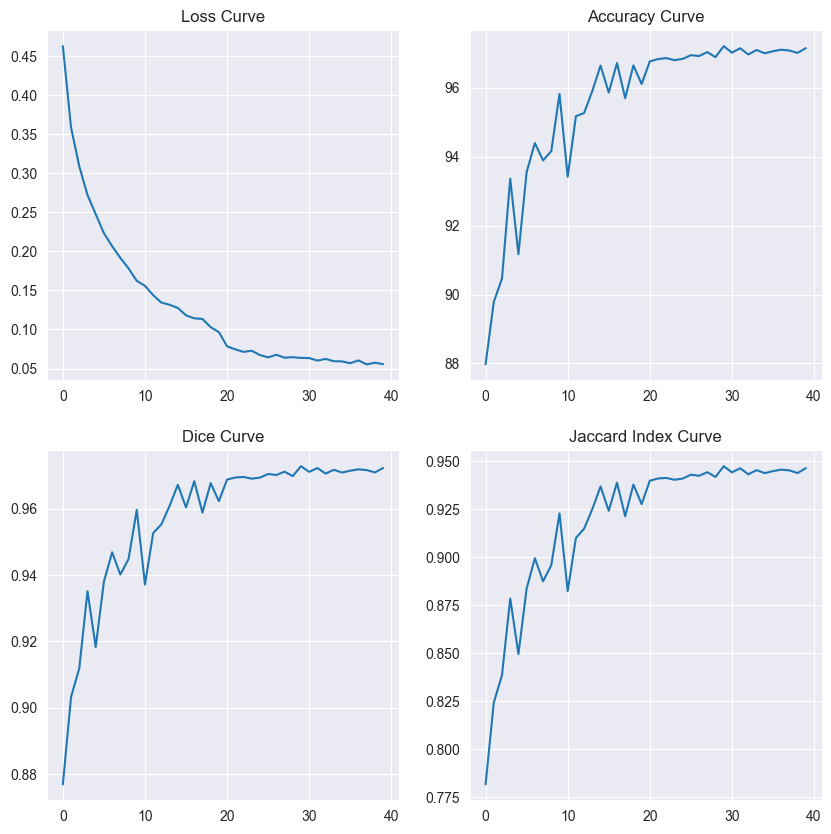

In [24]:
create_result_plot(df)

In [26]:
trained_model = UNET(in_channels=3, out_channels=1).to(DEVICE) # first_out_channels=64, exit_channels=1
load_checkpoint(torch.load("aug_full_train/checkpointV15-ft.pth.tar"), trained_model)

accuracy, dice_score, jaccard_index_score = check_accuracy(val_loader, trained_model, device=DEVICE)
print(f"VAL DATASET: {accuracy=}, {dice_score=}, {jaccard_index_score=}")

accuracy, dice_score, jaccard_index_score = check_accuracy(test_loader, trained_model, device=DEVICE)
print(f"TEST DATASET {accuracy=}, {dice_score=}, {jaccard_index_score=}")

=> Loading checkpoint
Got 12709348/13074432 with acc 97.21
Dice score: 0.9728761315345764
Jaccard Index score: 0.9472736120223999
VAL DATASET: accuracy=97.20764923095703, dice_score=0.9728761315345764, jaccard_index_score=0.9472736120223999
Got 5168973/6586368 with acc 78.48
Dice score: 0.7469800114631653
Jaccard Index score: 0.5975703597068787
TEST DATASET accuracy=78.47986602783203, dice_score=0.7469800114631653, jaccard_index_score=0.5975703597068787


=> Loading checkpoint
(1, 256, 128)


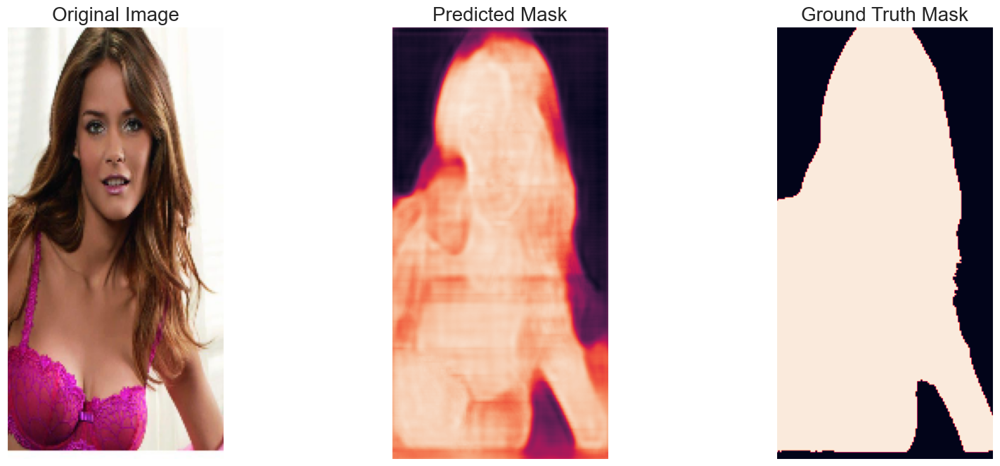

(1, 256, 128)


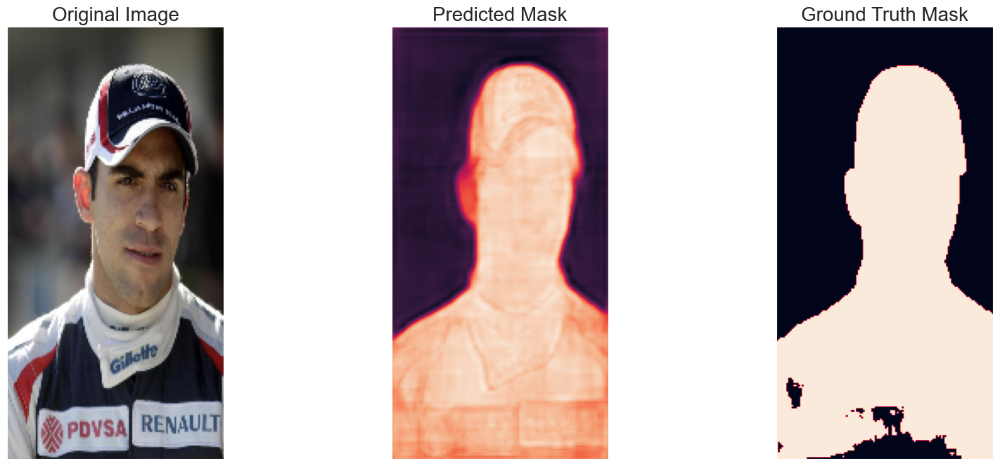

(1, 256, 128)


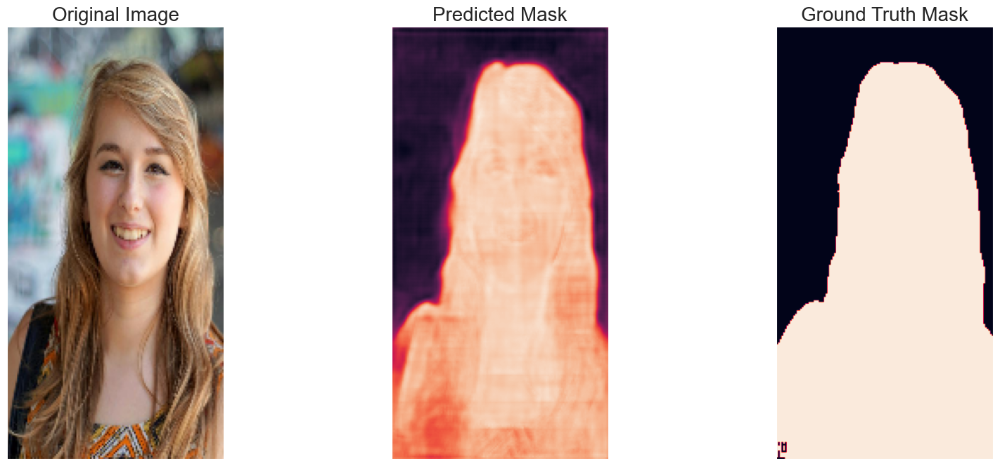

(1, 256, 128)


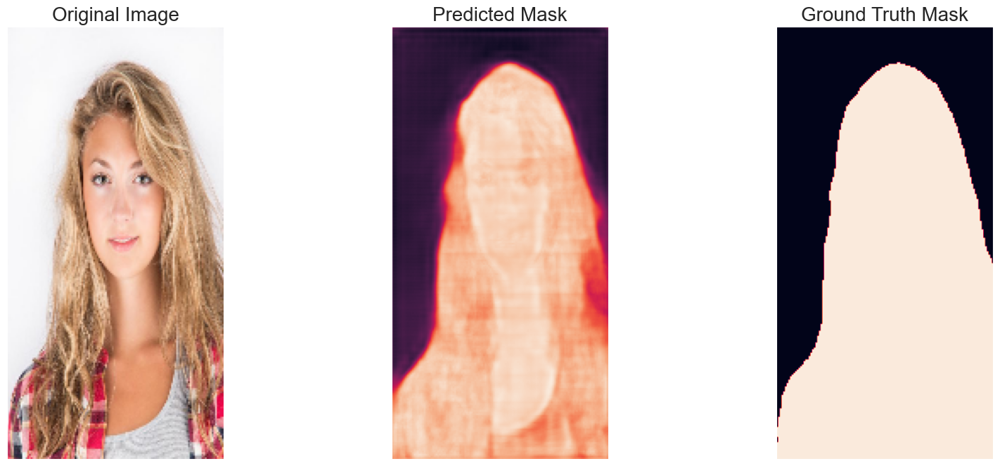

(1, 256, 128)


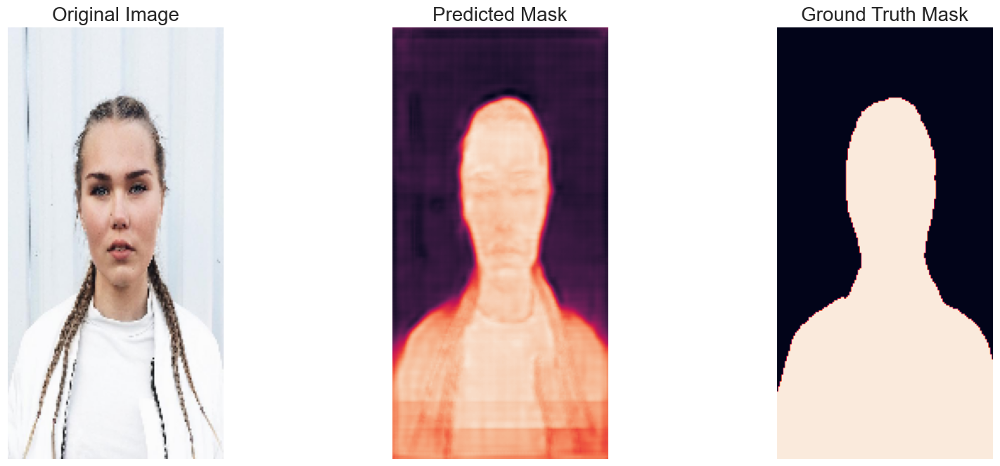

(1, 256, 128)


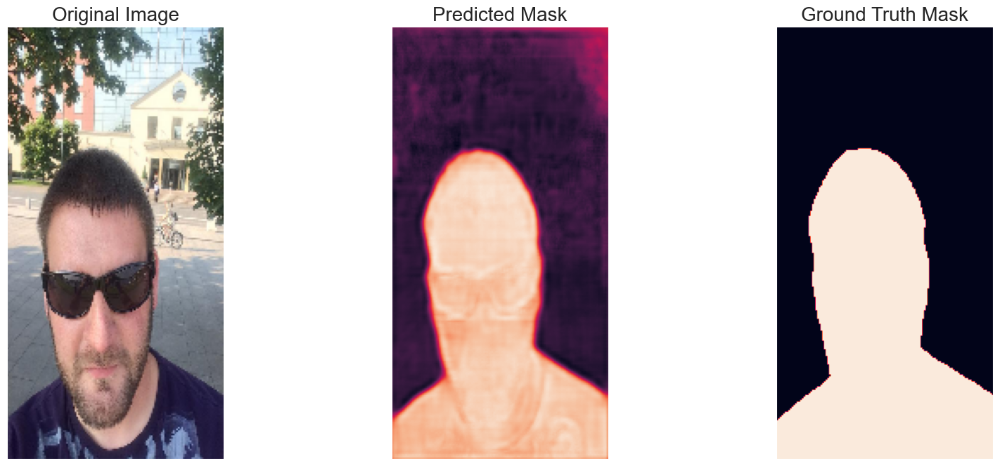

(1, 256, 128)


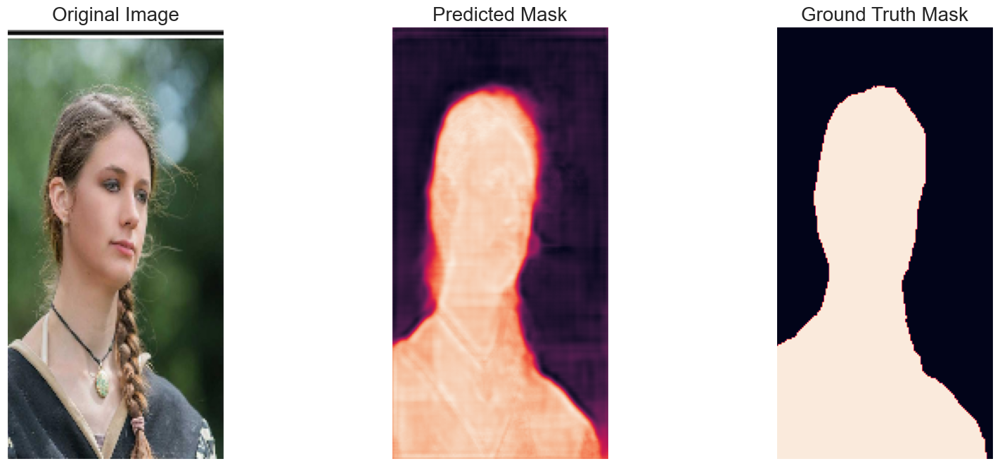

(1, 256, 128)


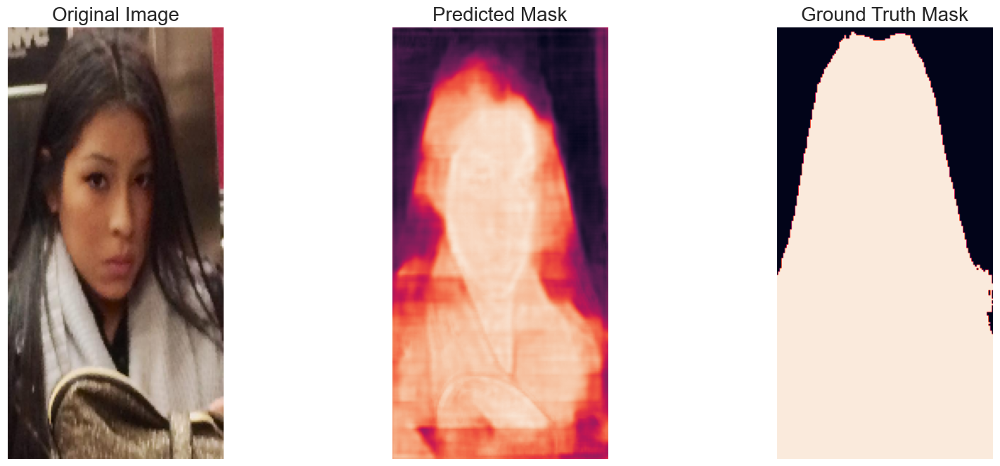

(1, 256, 128)


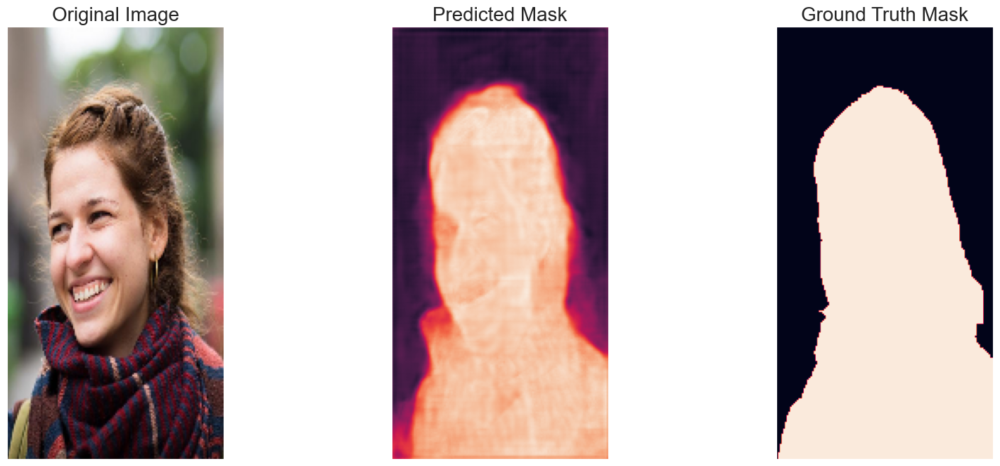

(1, 256, 128)


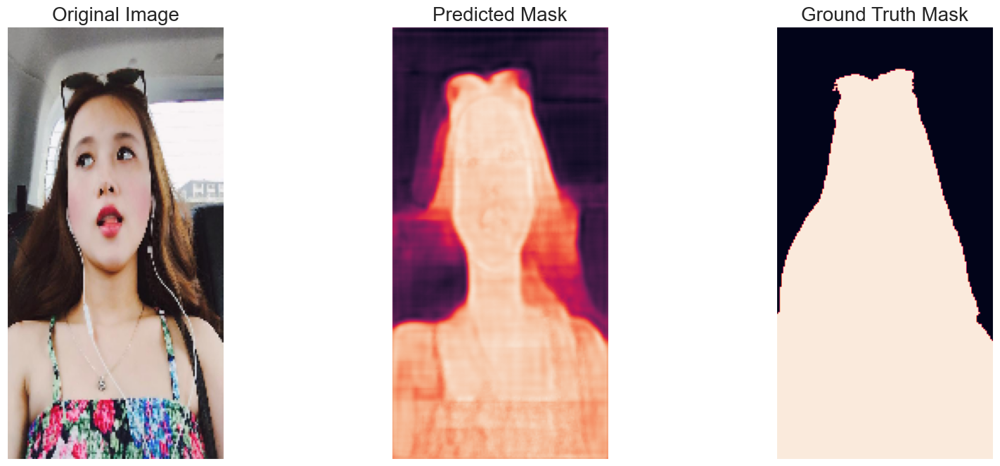

(1, 256, 128)


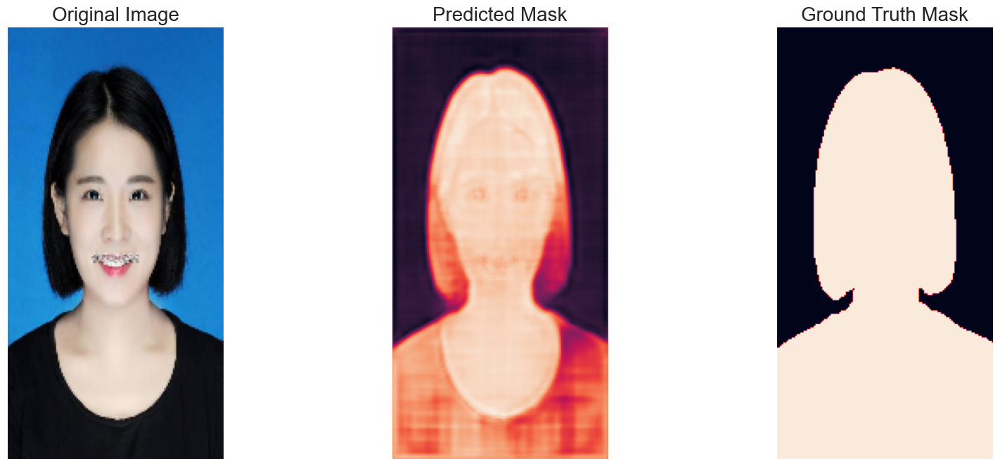

(1, 256, 128)


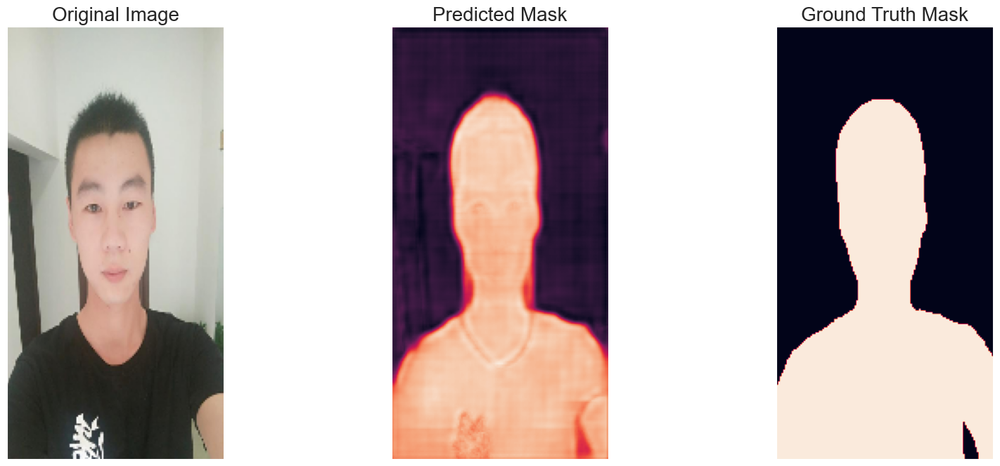

(1, 256, 128)


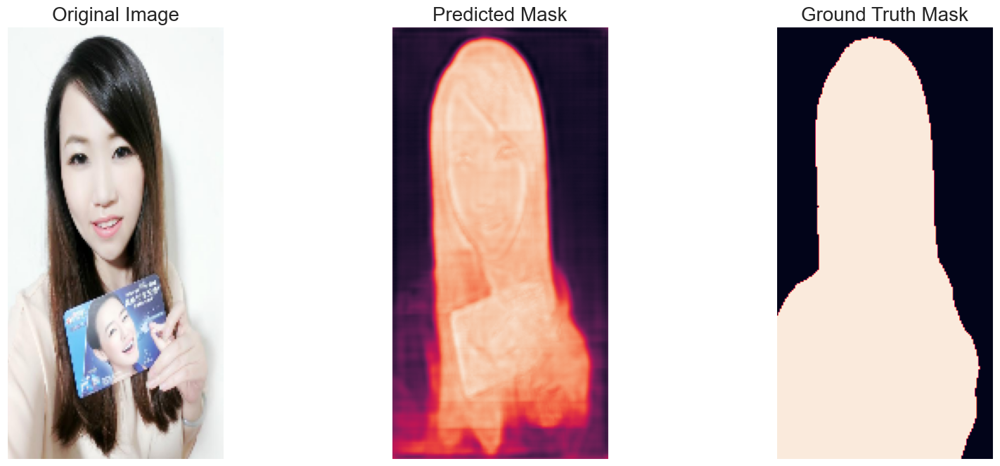

(1, 256, 128)


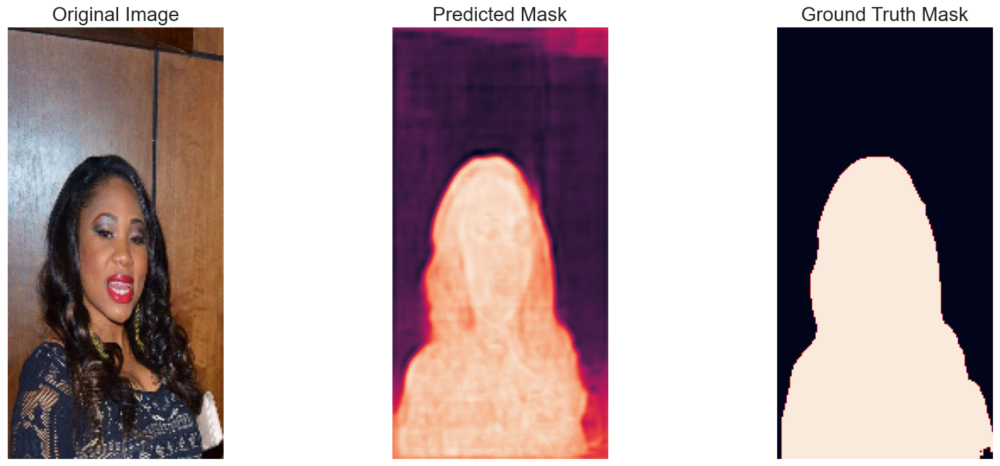

(1, 256, 128)


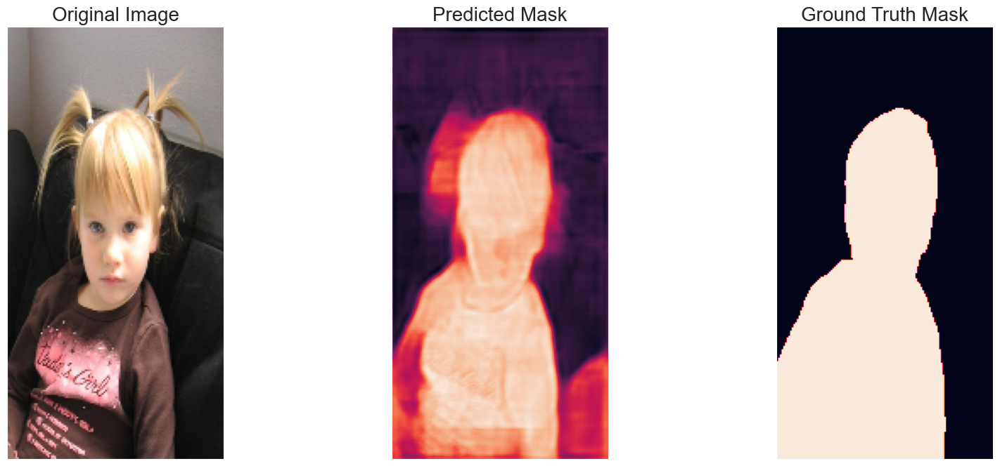

In [17]:
from hw.task3.dataset import SelfieDataset
from hw.task3.utils import load_checkpoint

best_model = None

# load best saved model checkpoint from the current run
if os.path.exists('aug_full_train/checkpointV15-ft.pth.tar'):
    best_model = UNET(in_channels=3, out_channels=1).to(DEVICE) # first_out_channels=64, exit_channels=1
    load_checkpoint(torch.load("aug_full_train/checkpointV15-ft.pth.tar"), best_model)

test_dataset = SelfieDataset(img_dir=TEST_IMG_PATH, mask_dir=TEST_MASK_PATH, transform=val_transforms)

for idx in range(min(len(test_dataset), 15)):

    image, gt_mask = test_dataset[idx]

    x_tensor = image.to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze(0).cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    print(pred_mask.shape)
    pred_mask = np.transpose(pred_mask,(1,2,0))

    # pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = gt_mask.unsqueeze(0)
    gt_mask = np.transpose(gt_mask,(1,2,0))
    image = np.transpose(image,(1,2,0))
    # gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
    # cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])
    
    visualize(
        original_image = image,
        predicted_mask = pred_mask,
        ground_truth_mask = gt_mask,
    )

#### Result

Как мы можем заметить по графикам([img](aug_full_train/results.png)) на полном train датасете с применением различных методов аугметации и поддором гиперпараметров(в данном ноутбуке представлен уже наилучший вариант) удалось обучиться до точности(на val dataset)
- Got 12709348/13074432 with acc 97.21
- Dice score: 0.9728761315345764
- Jaccard Index score: 0.9472736120223999

Однако на тестовом датасете результаты получились хуже чем без аугментации:
- Got 5168973/6586368 with acc 78.48
- Dice score: 0.7469800114631653
- Jaccard Index score: 0.5975703597068787

Пример предсказания:
- Исходная маска([link](aug_full_train/true.png))
- Предсказанная маска([link](aug_full_train/pred.png))

Перейдем к обучению модели с уже предобученным encoder, для теста взята модель ResNet-50.

## Pre-trained Encoder Resnet-50

In [6]:
import segmentation_models_pytorch as smp

In [7]:
from segmentation_models_pytorch import utils

In [8]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation

# create segmentation model with pretrained encoder
model = smp.Unet(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=1, 
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

#### Set Hyperparams

In [10]:
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 10
IMAGE_HEIGHT = 256
IMAGE_WIDTH = 128
BATCH_SIZE = 16

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
loss = utils.losses.BCEWithLogitsLoss() # DiceLoss() # 

# define metrics
metrics = [
    utils.metrics.Accuracy(),
    utils.metrics.IoU(threshold=0.5), # Jaccard Index Score
]

# define optimizer
optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.001),
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

# load best saved model checkpoint from previous commit (if present)
# if os.path.exists('pretrained_encoder/best_model.pth'):
#     model = torch.load('pretrained_encoder/best_model.pth', map_location=DEVICE)

In [11]:
train_epoch = utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

In [12]:
train_transform = A.Compose(
    [
        A.Resize(height=IMAGE_HEIGHT, width=IMAGE_WIDTH),
        # A.Rotate(limit=35, p=1.0),
        # A.HorizontalFlip(p=0.5),
        # A.VerticalFlip(p=0.1),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

val_transforms = A.Compose(
    [
        A.Resize(height=IMAGE_HEIGHT, width=IMAGE_WIDTH),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

In [25]:
from hw.task3.dataset2 import SelfieDatasetV2
from torch.utils.data import DataLoader

def get_loader(img_dir,
                      mask_dir,
                      batch_size,
                      transform,
                      num_workers=8,
                      pin_memory=True,):
    ds = SelfieDatasetV2(
        img_dir=img_dir,
        mask_dir=mask_dir,
        transform=transform,
    )

    loader = DataLoader(
        ds,
        batch_size=batch_size,
        num_workers=num_workers,
        pin_memory=pin_memory,
        shuffle=True,
    )

    return loader

In [26]:
from hw.task3.utils import get_loaders, load_checkpoint, check_accuracy, save_checkpoint, save_predictions_as_imgs, get_single_loader
NUM_WORKERS = os.cpu_count()
PIN_MEMORY = True
train_loader = get_loader(TRAIN_IMG_PATH, TRAIN_MASK_PATH, BATCH_SIZE, train_transform, NUM_WORKERS, PIN_MEMORY)
val_loader = get_loader(VAL_IMG_PATH, VAL_MASK_PATH, BATCH_SIZE, val_transforms, NUM_WORKERS, PIN_MEMORY)
test_loader = get_loader(TEST_IMG_PATH, TEST_MASK_PATH, BATCH_SIZE, val_transforms, NUM_WORKERS, PIN_MEMORY)

### Training UNet

In [27]:
%%time

train_logs_list, valid_logs_list = [], []

if TRAINING:

    best_iou_score = 0.0

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(val_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, 'pretrained_encoder/best_model.pth')
            print('Model saved!')


Epoch: 0
valid: 100%|██████████| 25/25 [00:10<00:00,  2.33it/s, bce_with_logits_loss - 0.5196, accuracy - 0.9623, iou_score - 0.9278]
Model saved!

Epoch: 1
valid: 100%|██████████| 25/25 [00:08<00:00,  2.88it/s, bce_with_logits_loss - 0.5137, accuracy - 0.9689, iou_score - 0.94]  
Model saved!

Epoch: 2
valid: 100%|██████████| 25/25 [00:08<00:00,  2.92it/s, bce_with_logits_loss - 0.5141, accuracy - 0.9713, iou_score - 0.9456]
Model saved!

Epoch: 3
valid: 100%|██████████| 25/25 [00:08<00:00,  2.93it/s, bce_with_logits_loss - 0.5157, accuracy - 0.9622, iou_score - 0.9275]

Epoch: 4
valid: 100%|██████████| 25/25 [00:10<00:00,  2.49it/s, bce_with_logits_loss - 0.5161, accuracy - 0.9606, iou_score - 0.9247]

Epoch: 5
valid: 100%|██████████| 25/25 [00:09<00:00,  2.58it/s, bce_with_logits_loss - 0.5146, accuracy - 0.9671, iou_score - 0.9374]

Epoch: 6
valid: 100%|██████████| 25/25 [00:10<00:00,  2.44it/s, bce_with_logits_loss - 0.5088, accuracy - 0.9793, iou_score - 0.9603]
Model saved!

Ep

In [21]:
test_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

valid_logs = test_epoch.run(test_loader)
print("Evaluation on Test Data: ")
print(f"Mean IoU(Jaccard Index) Score: {valid_logs['iou_score']:.4f}")
print(f"Mean Accuracy Loss: {valid_logs['accuracy']:.4f}")

NameError: name 'smp' is not defined

### Plot Dice Loss & IoU(Jaccard Index) Metric for Train vs. Val

In [32]:
train_logs_df = pd.DataFrame(train_logs_list)
valid_logs_df = pd.DataFrame(valid_logs_list)
train_logs_df.T

,0,1,2,3,4,5,6,7,8,9
bce_with_logits_loss,0.548706,0.519772,0.515875,0.515731,0.518678,0.514352,0.513021,0.510924,0.510053,0.509141
accuracy,0.942489,0.970035,0.975370,0.974184,0.969055,0.977164,0.979868,0.984207,0.986556,0.988287
iou_score,0.897588,0.941649,0.951810,0.949478,0.939905,0.955245,0.960479,0.968842,0.973456,0.976842


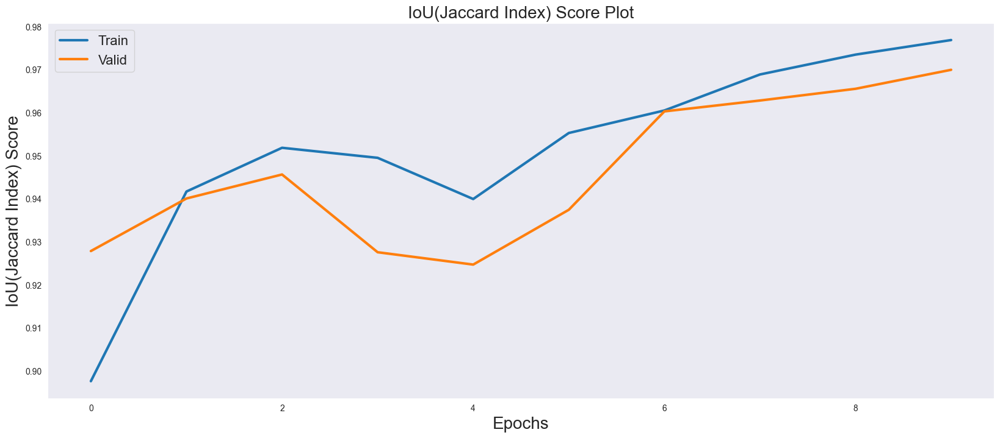

In [33]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('IoU(Jaccard Index) Score', fontsize=20)
plt.title('IoU(Jaccard Index) Score Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('pretrained_encoder/iou_score_plot.png')
plt.show()

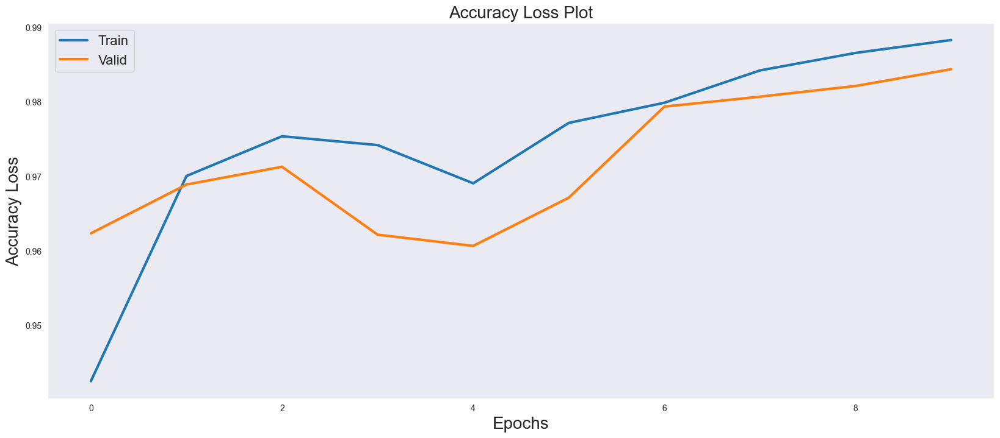

In [35]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.accuracy.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.accuracy.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Accuracy Loss', fontsize=20)
plt.title('Accuracy Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('pretrained_encoder/accuracy_plot.png')
plt.show()

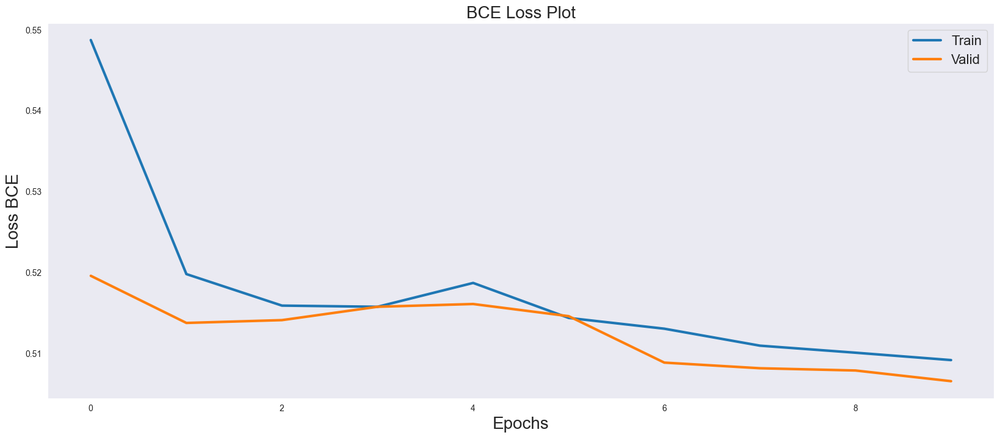

In [36]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.bce_with_logits_loss.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.bce_with_logits_loss.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Loss BCE', fontsize=20)
plt.title('BCE Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('pretrained_encoder/bce_loss_plot.png')
plt.show()

Loaded UNet model from this run.
(1, 256, 128)


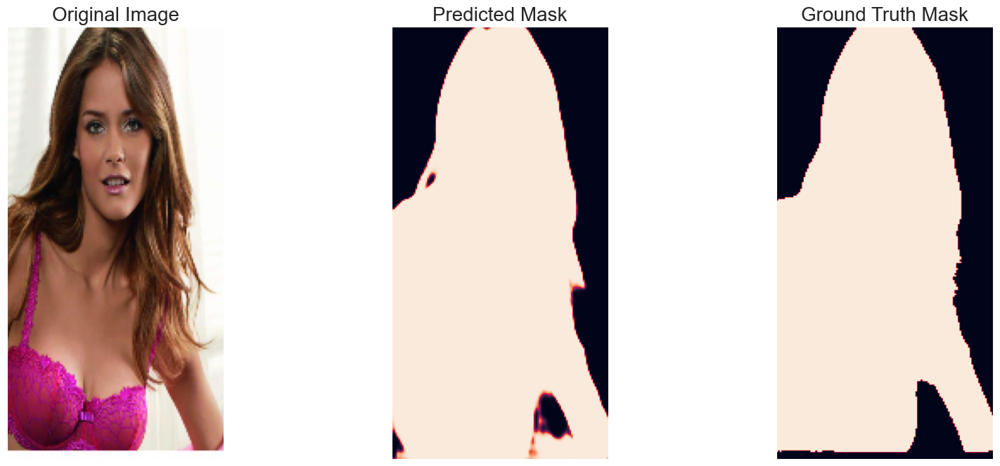

(1, 256, 128)


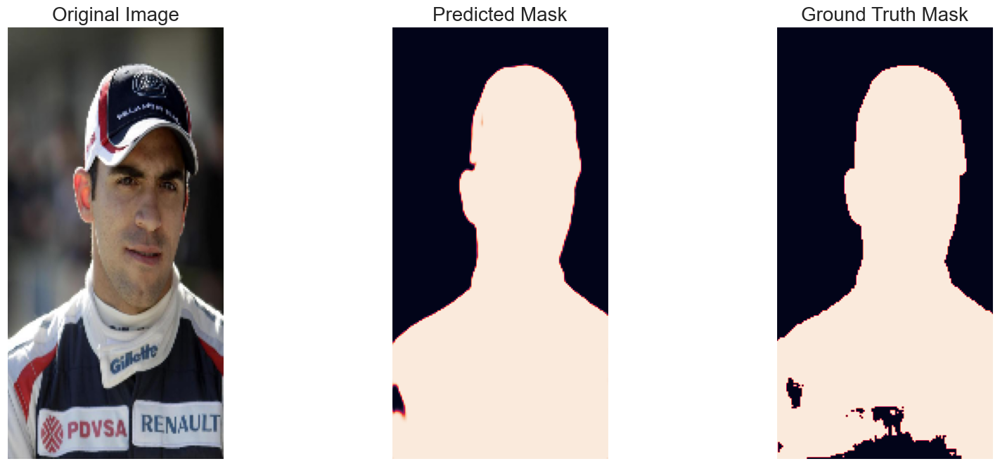

(1, 256, 128)


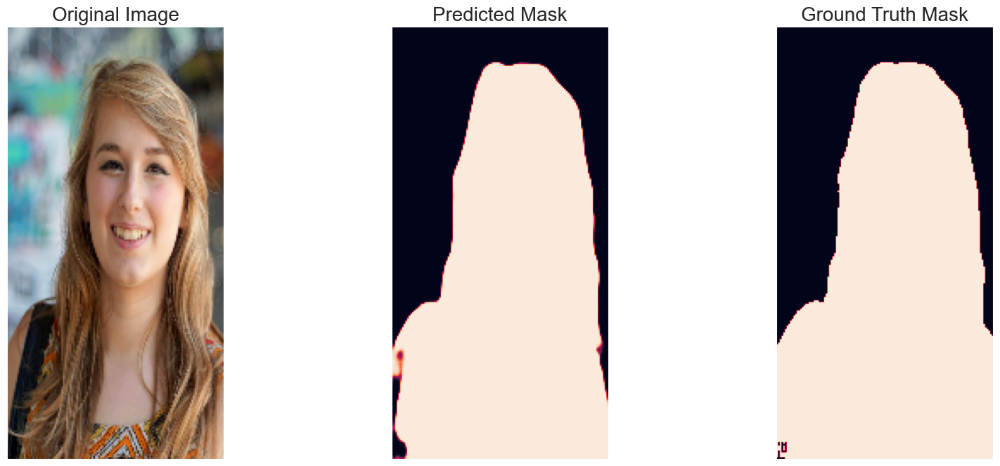

(1, 256, 128)


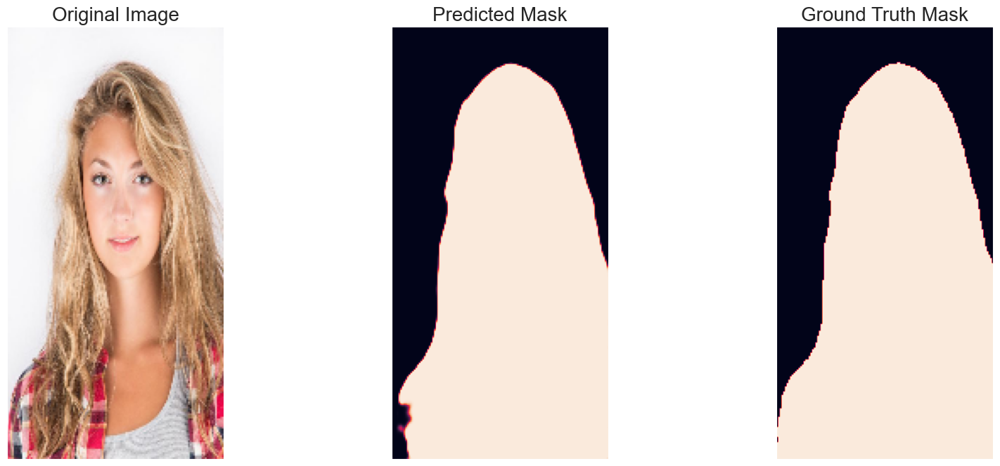

(1, 256, 128)


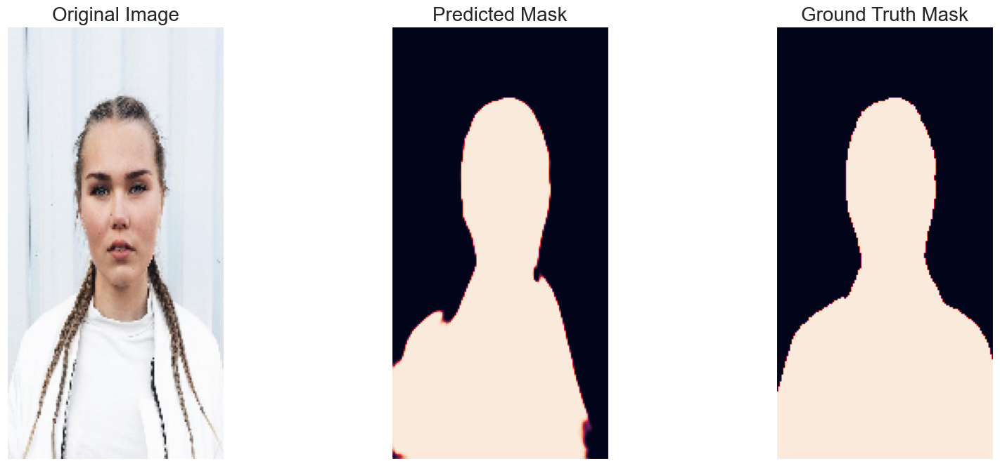

(1, 256, 128)


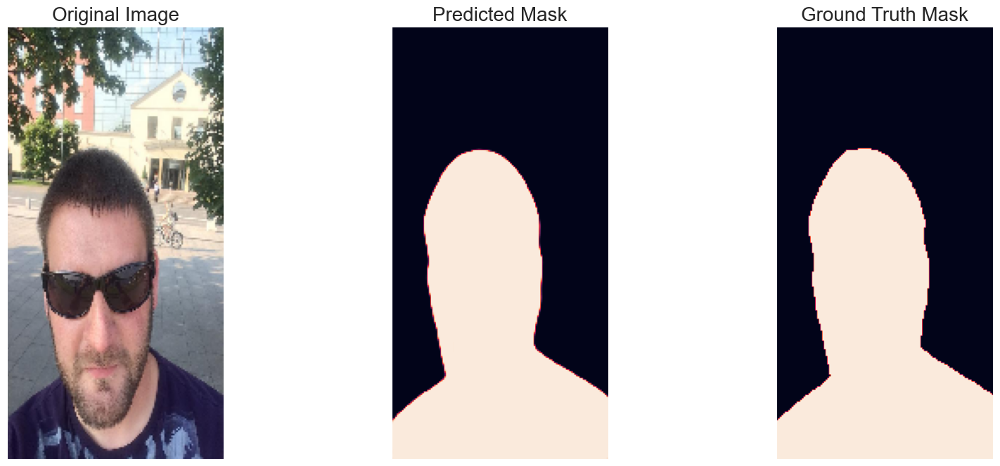

(1, 256, 128)


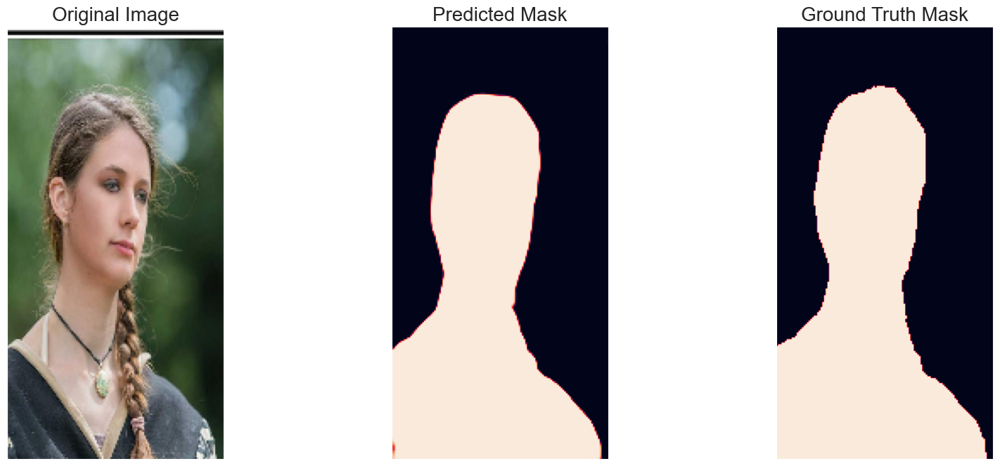

(1, 256, 128)


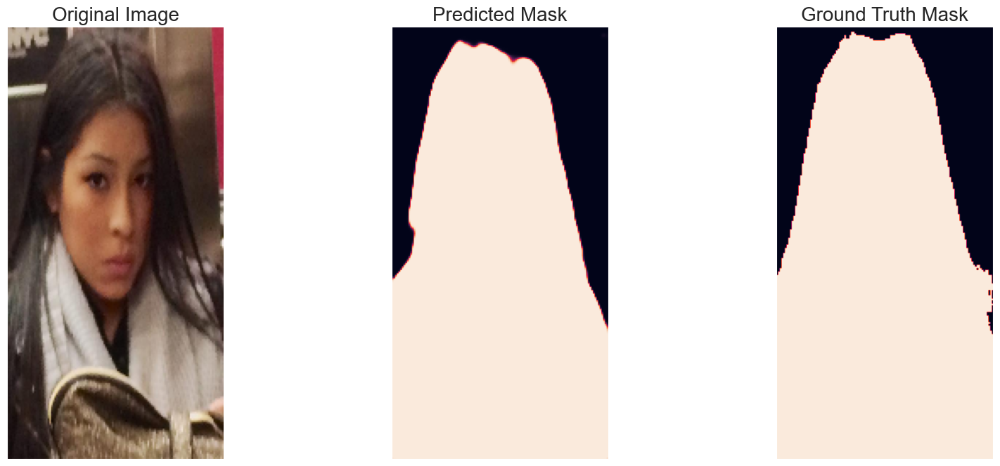

(1, 256, 128)


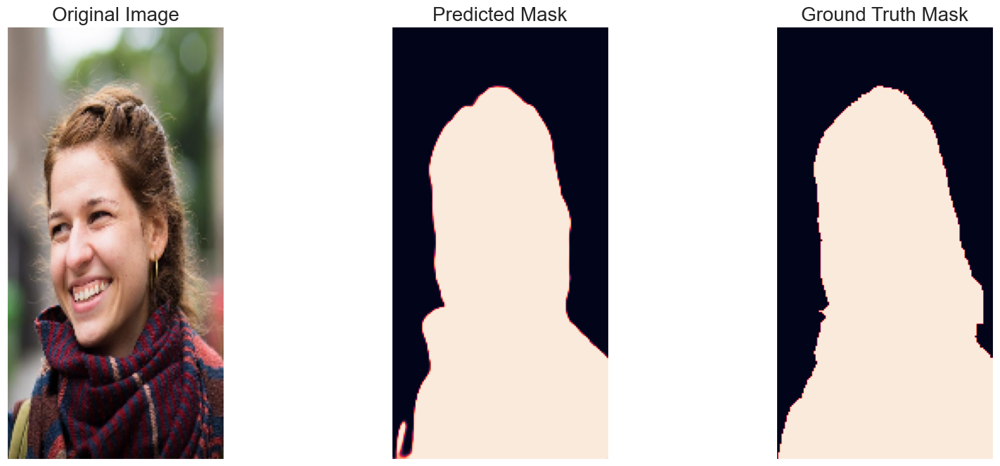

(1, 256, 128)


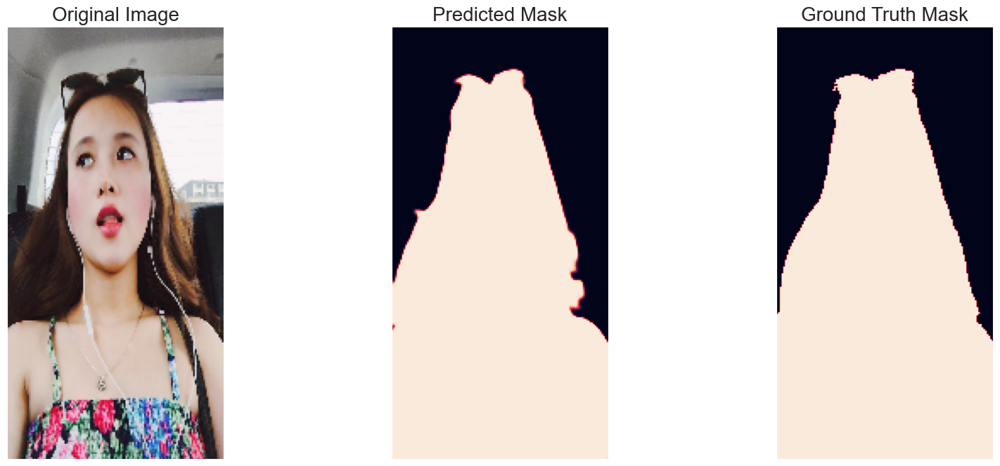

(1, 256, 128)


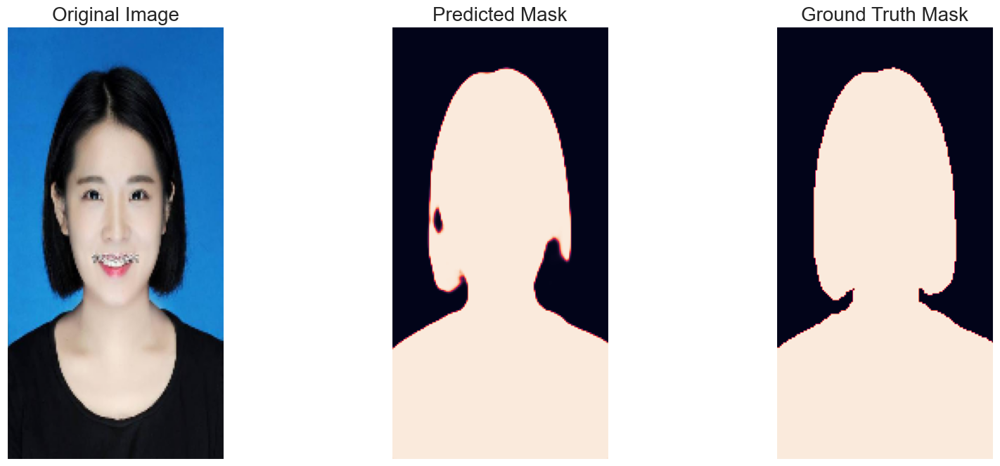

(1, 256, 128)


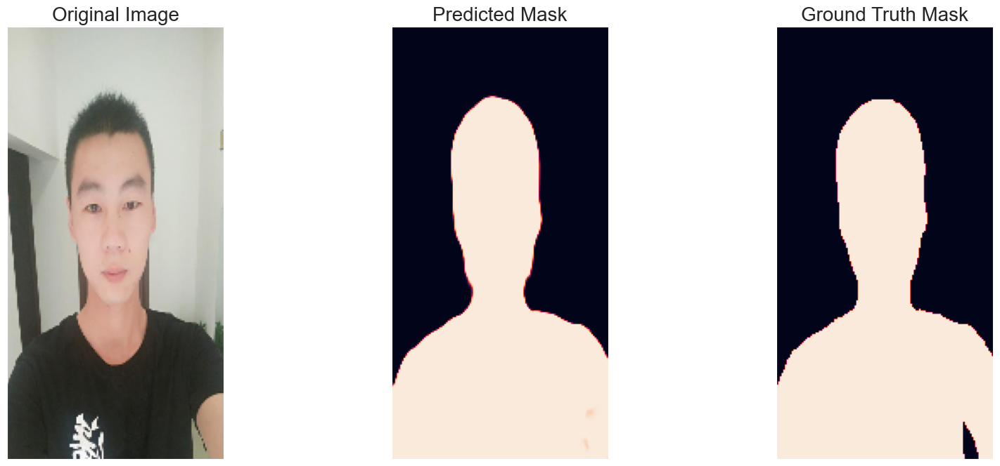

(1, 256, 128)


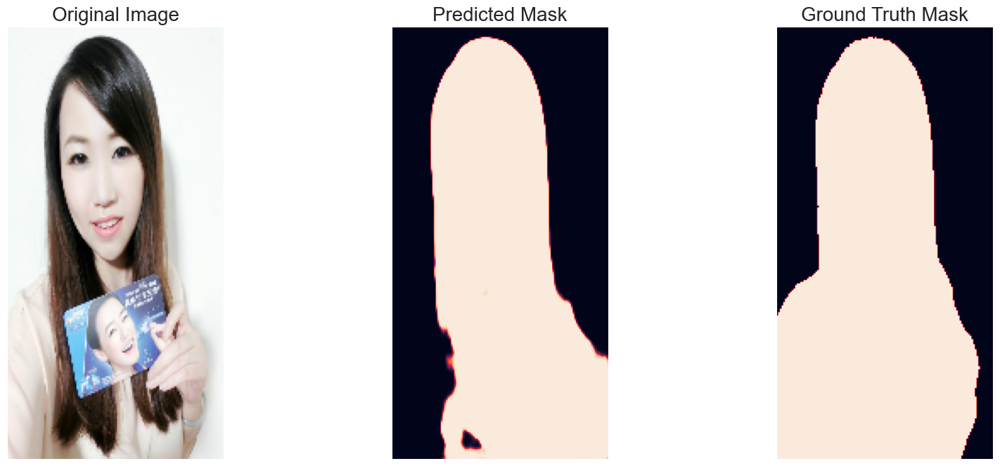

(1, 256, 128)


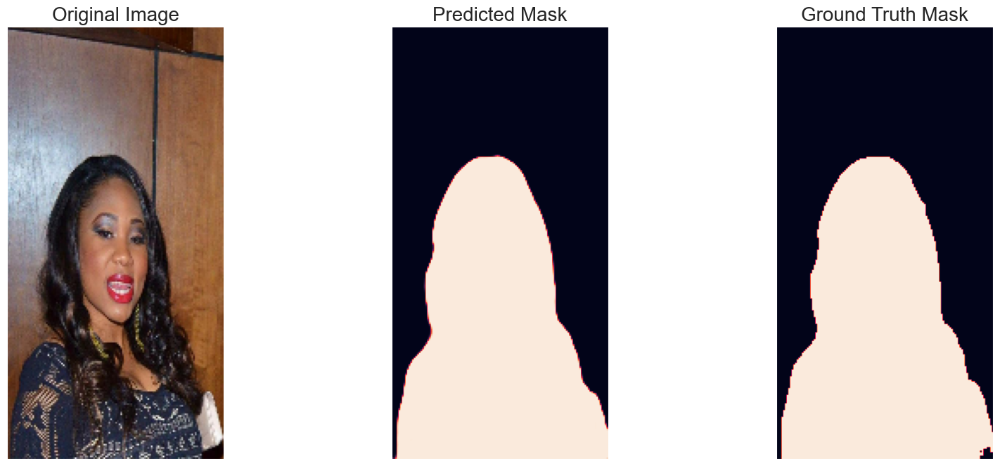

(1, 256, 128)


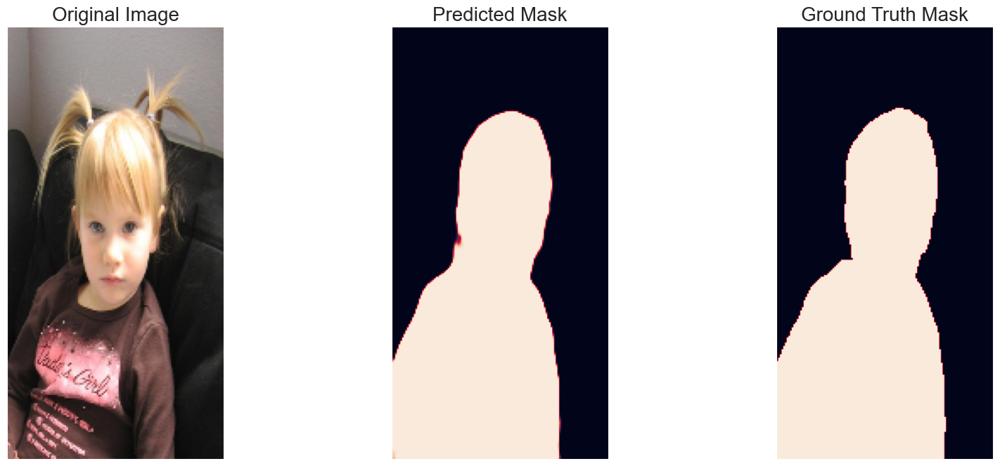

In [23]:
from hw.task3.dataset import SelfieDataset

# load best saved model checkpoint from the current run
if os.path.exists('pretrained_encoder/best_model.pth'):
    best_model = torch.load('pretrained_encoder/best_model.pth', map_location=DEVICE)
    print('Loaded UNet model from this run.')
    
test_dataset = SelfieDataset(img_dir=TEST_IMG_PATH, mask_dir=TEST_MASK_PATH, transform=val_transforms)

for idx in range(min(len(test_dataset), 15)):

    image, gt_mask = test_dataset[idx]

    x_tensor = image.to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze(0).cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    print(pred_mask.shape)
    pred_mask = np.transpose(pred_mask,(1,2,0))

    # pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = gt_mask.unsqueeze(0)
    gt_mask = np.transpose(gt_mask,(1,2,0))
    image = np.transpose(image,(1,2,0))
    # gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
    # cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])
    
    visualize(
        original_image = image,
        predicted_mask = pred_mask,
        ground_truth_mask = gt_mask,
    )

#### Result

Как мы можем заметить по графикам([jaccard](pretrained_encoder/iou_score_plot.png) и [accuracy](pretrained_encoder/accuracy_loss_plot.png)) удалось обучиться на тестовом датасете до точности 
- Accuracy 0.988287
- Jaccard Index score: 0.976842

Данный показатель является наилучшим, из полученных за все итерации обучения, всего за 10 эпох. Скорее всего, данный показатель можно улучшить еще сильнее, однако для сравнения с другими моделями, как являющийся top на данный момент не имеет смысла

Не смотря на уже очень высокое качество сегментации, можно попробовать в целях эксперимента рассмотреть и еще совершенно другую архитектуру.

## MAnet Segmentation --- Different architecture

In [43]:
import segmentation_models_pytorch as smp

In [44]:
from segmentation_models_pytorch import utils

In [54]:
ENCODER = 'resnet50'
ENCODER_WEIGHTS = 'imagenet'
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation

# create segmentation model with pretrained encoder
model = smp.MAnet(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=1, 
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

#### Set Hyperparams

In [55]:
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 25
IMAGE_HEIGHT = 256
IMAGE_WIDTH = 128
BATCH_SIZE = 16

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
loss = utils.losses.BCEWithLogitsLoss() # DiceLoss() # 

# define metrics
metrics = [
    utils.metrics.Accuracy(),
    utils.metrics.IoU(threshold=0.5), # Jaccard Index Score
]

# define optimizer
optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.001),
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

# load best saved model checkpoint from previous commit (if present)
# if os.path.exists('pretrained_encoder/best_model.pth'):
#     model = torch.load('pretrained_encoder/best_model.pth', map_location=DEVICE)

In [56]:
train_epoch = utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

In [57]:
train_transform = A.Compose(
    [
        A.Resize(height=IMAGE_HEIGHT, width=IMAGE_WIDTH),
        # A.Rotate(limit=35, p=1.0),
        # A.HorizontalFlip(p=0.5),
        # A.VerticalFlip(p=0.1),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

val_transforms = A.Compose(
    [
        A.Resize(height=IMAGE_HEIGHT, width=IMAGE_WIDTH),
        A.Normalize(
            mean=[0.0, 0.0, 0.0],
            std=[1.0, 1.0, 1.0],
            max_pixel_value=255.0,
        ),
        ToTensorV2(),
    ],
)

In [58]:
from hw.task3.dataset2 import SelfieDatasetV2
from torch.utils.data import DataLoader

def get_loader(img_dir,
                      mask_dir,
                      batch_size,
                      transform,
                      num_workers=8,
                      pin_memory=True,):
    ds = SelfieDatasetV2(
        img_dir=img_dir,
        mask_dir=mask_dir,
        transform=transform,
    )

    loader = DataLoader(
        ds,
        batch_size=batch_size,
        num_workers=num_workers,
        pin_memory=pin_memory,
        shuffle=True,
    )

    return loader

In [59]:
from hw.task3.utils import get_loaders, load_checkpoint, check_accuracy, save_checkpoint, save_predictions_as_imgs, get_single_loader
NUM_WORKERS = os.cpu_count()
PIN_MEMORY = True
train_loader = get_loader(TRAIN_IMG_PATH, TRAIN_MASK_PATH, BATCH_SIZE, train_transform, NUM_WORKERS, PIN_MEMORY)
val_loader = get_loader(VAL_IMG_PATH, VAL_MASK_PATH, BATCH_SIZE, val_transforms, NUM_WORKERS, PIN_MEMORY)
test_loader = get_loader(TEST_IMG_PATH, TEST_MASK_PATH, BATCH_SIZE, val_transforms, NUM_WORKERS, PIN_MEMORY)

### Training MAnet

In [60]:
%%time

train_logs_list, valid_logs_list = [], []

if TRAINING:

    best_iou_score = 0.0

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(val_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, 'manet_pretrained_encoder/best_modelV2.pth')
            print('Model saved!')


Epoch: 0
valid: 100%|██████████| 25/25 [00:14<00:00,  1.72it/s, bce_with_logits_loss - 0.5748, accuracy - 0.8733, iou_score - 0.7977]
Model saved!

Epoch: 1
valid: 100%|██████████| 25/25 [00:12<00:00,  1.93it/s, bce_with_logits_loss - 0.525, accuracy - 0.9488, iou_score - 0.9048] 
Model saved!

Epoch: 2
valid: 100%|██████████| 25/25 [00:10<00:00,  2.36it/s, bce_with_logits_loss - 0.5151, accuracy - 0.9644, iou_score - 0.9317]
Model saved!

Epoch: 3
valid: 100%|██████████| 25/25 [00:11<00:00,  2.13it/s, bce_with_logits_loss - 0.5115, accuracy - 0.974, iou_score - 0.9503] 
Model saved!

Epoch: 4
valid: 100%|██████████| 25/25 [00:12<00:00,  1.97it/s, bce_with_logits_loss - 0.5112, accuracy - 0.9748, iou_score - 0.9518]
Model saved!

Epoch: 5
valid: 100%|██████████| 25/25 [00:10<00:00,  2.48it/s, bce_with_logits_loss - 0.5107, accuracy - 0.9762, iou_score - 0.9545]
Model saved!

Epoch: 6
valid: 100%|██████████| 25/25 [00:12<00:00,  1.93it/s, bce_with_logits_loss - 0.5112, accuracy - 0.972

In [61]:
test_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

valid_logs = test_epoch.run(test_loader)
print("Evaluation on Test Data: ")
print(f"Mean IoU(Jaccard Index) Score: {valid_logs['iou_score']:.4f}")
print(f"Mean Accuracy Loss: {valid_logs['accuracy']:.4f}")

valid: 100%|██████████| 13/13 [00:09<00:00,  1.37it/s, bce_with_logits_loss - 0.5147, accuracy - 0.9792, iou_score - 0.9592]
Evaluation on Test Data: 
Mean IoU(Jaccard Index) Score: 0.9592
Mean Accuracy Loss: 0.9792


### Plot Dice Loss & IoU(Jaccard Index) Metric for Train vs. Val

In [62]:
train_logs_df = pd.DataFrame(train_logs_list)
valid_logs_df = pd.DataFrame(valid_logs_list)
train_logs_df.T

,0,1,2,3,4,5,6,7,8,9,...,15,16,17,18,19,20,21,22,23,24
bce_with_logits_loss,0.550180,0.529210,0.522304,0.516564,0.514293,0.513478,0.513055,0.513987,0.513540,0.513703,...,0.510469,0.509183,0.508960,0.508602,0.509412,0.510140,0.509338,0.509832,0.509247,0.510086
accuracy,0.922854,0.947097,0.961335,0.972629,0.977628,0.979216,0.980112,0.977491,0.978811,0.978014,...,0.985439,0.987979,0.988299,0.989261,0.987601,0.986094,0.987641,0.986561,0.987914,0.986212
iou_score,0.863203,0.898590,0.925290,0.946478,0.956176,0.959242,0.960951,0.955814,0.958378,0.956903,...,0.971268,0.976136,0.976861,0.978720,0.975364,0.972528,0.975563,0.973498,0.976098,0.972847


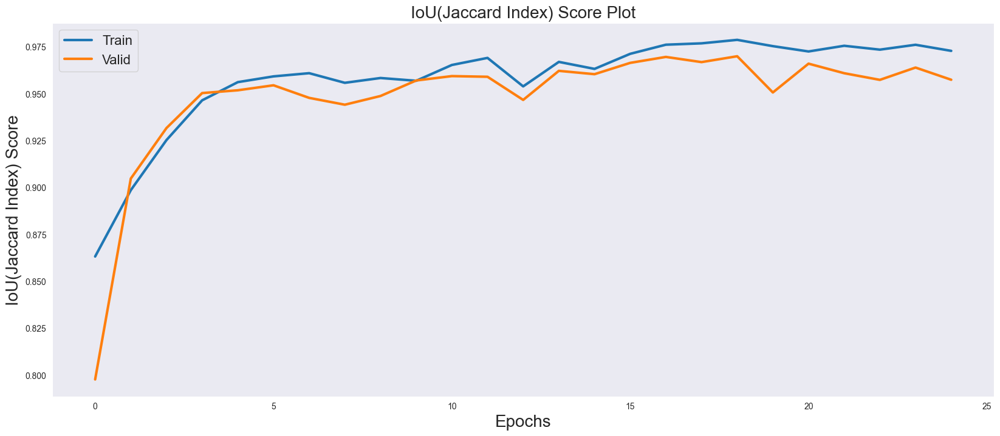

In [63]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('IoU(Jaccard Index) Score', fontsize=20)
plt.title('IoU(Jaccard Index) Score Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('manet_pretrained_encoder/iou_score_plot.png')
plt.show()

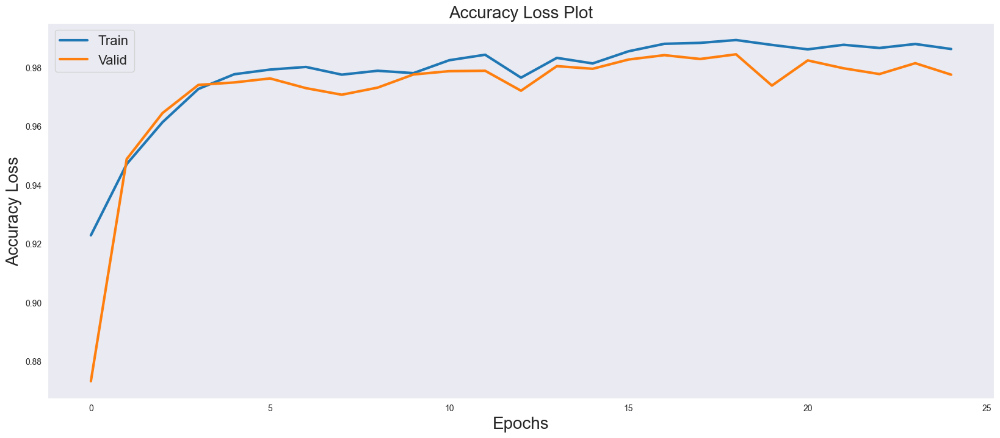

In [64]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.accuracy.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.accuracy.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Accuracy Loss', fontsize=20)
plt.title('Accuracy Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('manet_pretrained_encoder/accuracy_loss_plot.png')
plt.show()

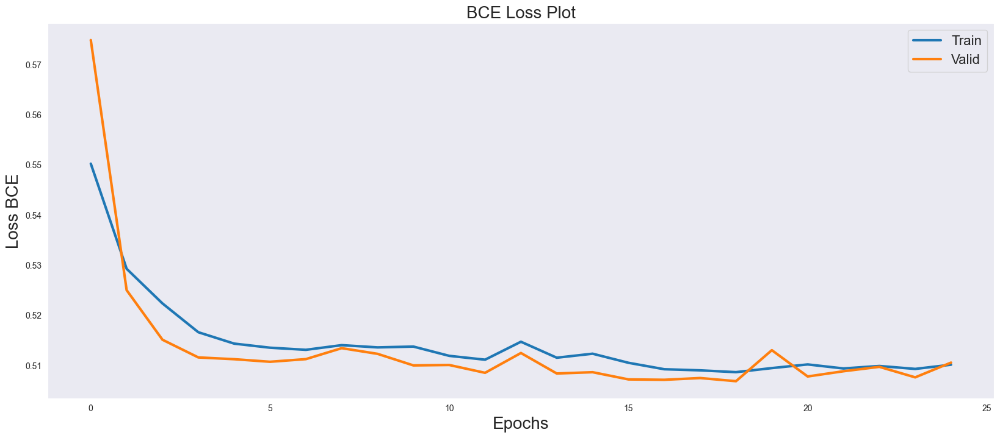

In [66]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.bce_with_logits_loss.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.bce_with_logits_loss.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Loss BCE', fontsize=20)
plt.title('BCE Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('manet_pretrained_encoder/bce_loss_plot.png')
plt.show()

Loaded UNet model from this run.
(1, 256, 128)


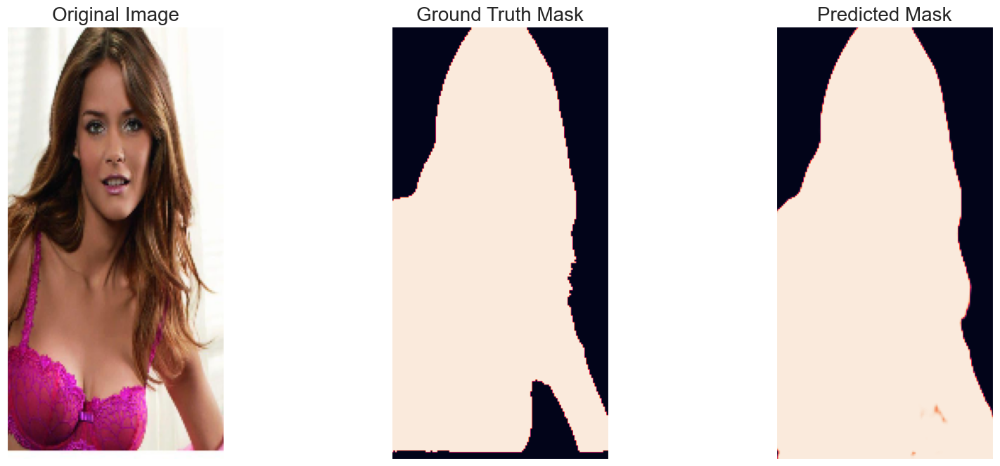

(1, 256, 128)


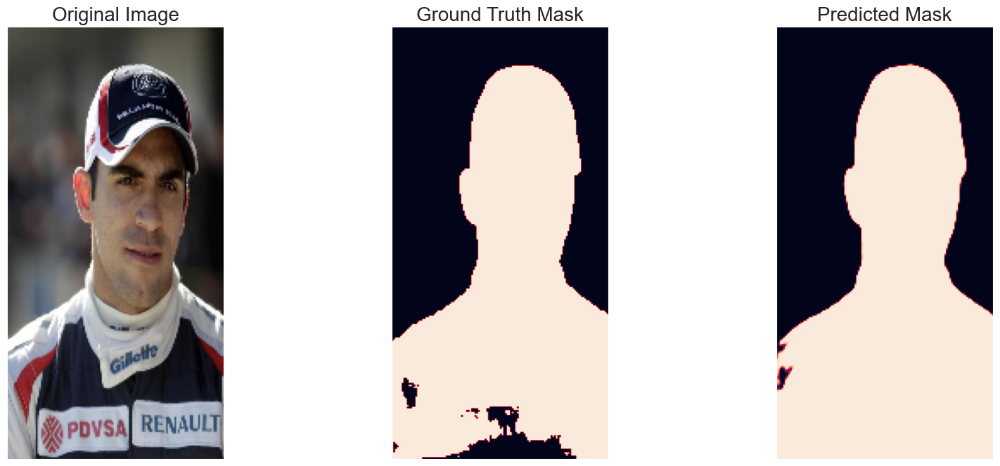

(1, 256, 128)


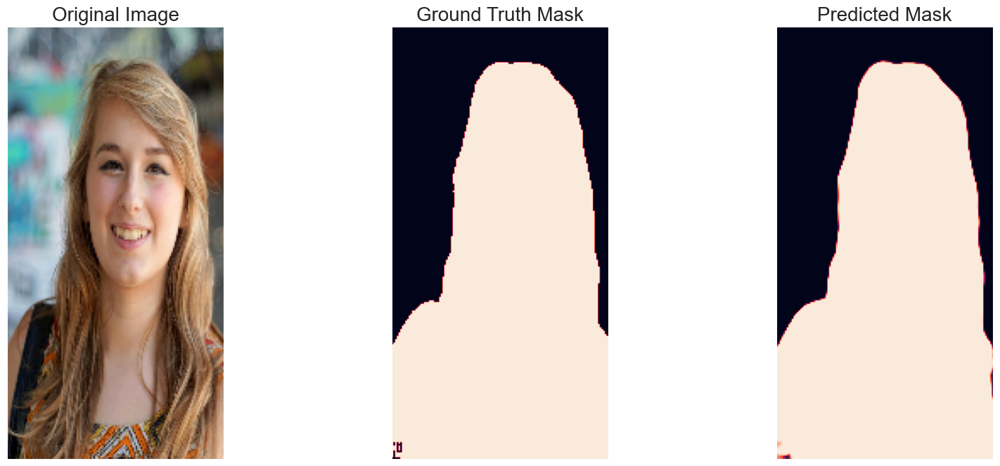

(1, 256, 128)


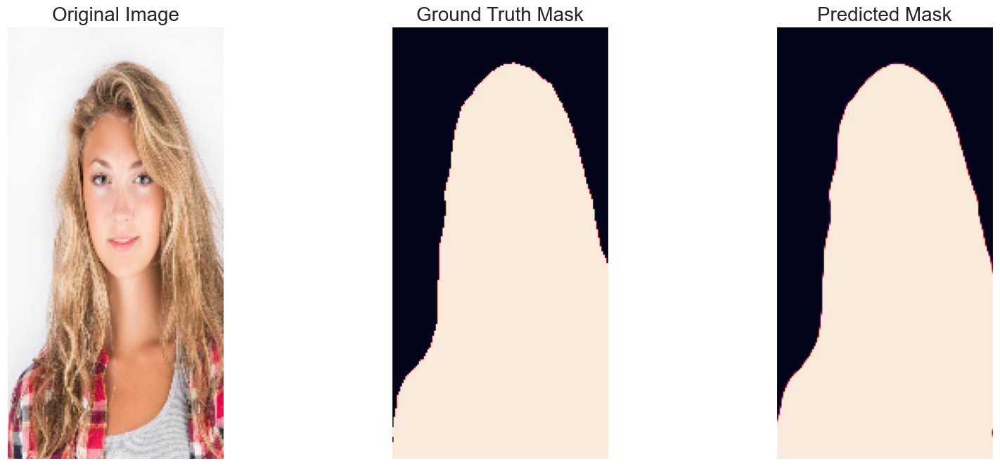

(1, 256, 128)


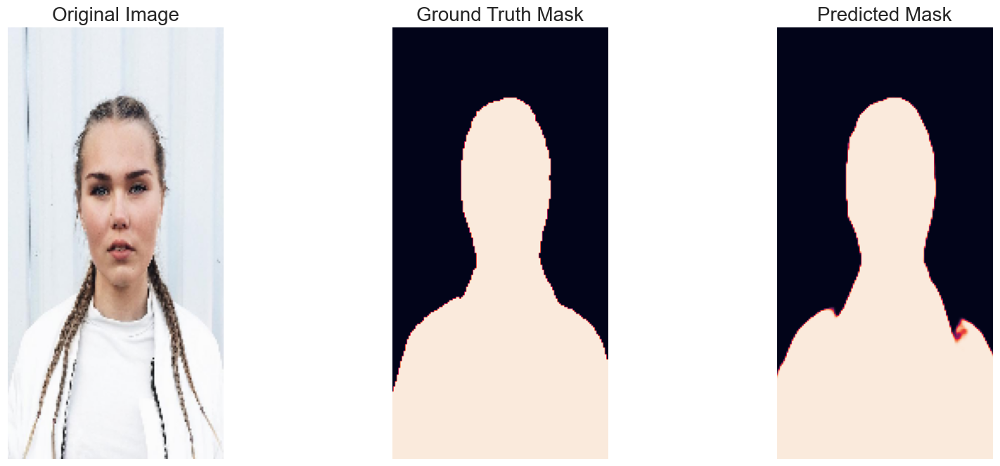

(1, 256, 128)


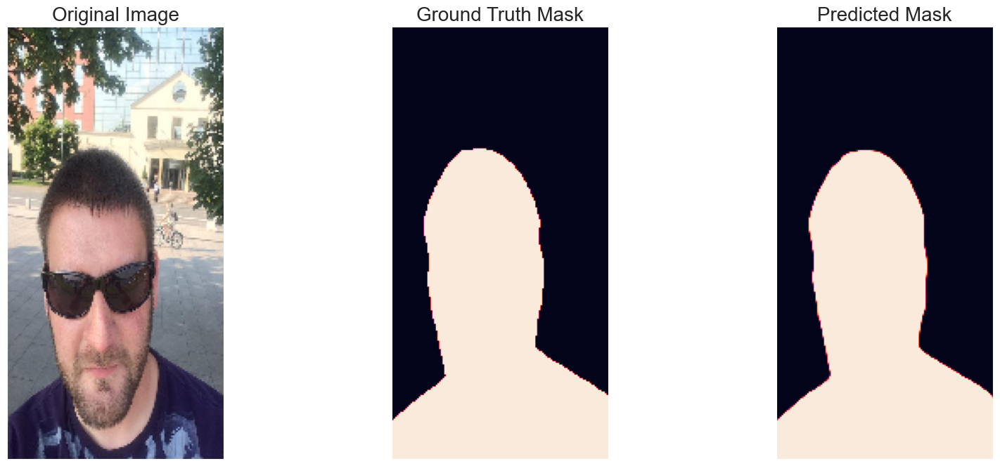

(1, 256, 128)


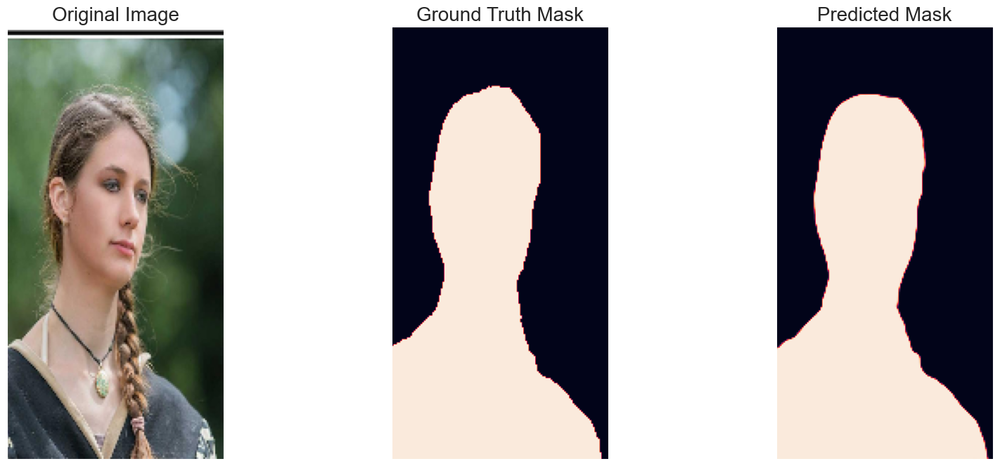

(1, 256, 128)


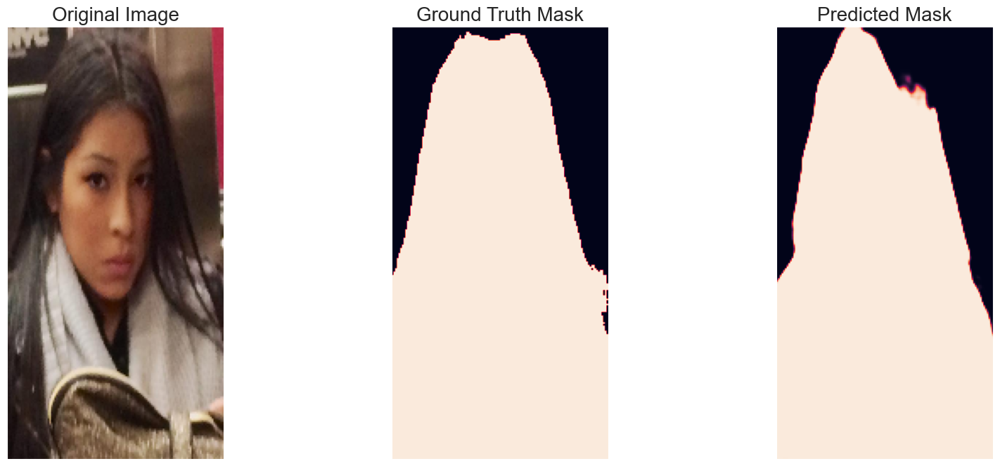

(1, 256, 128)


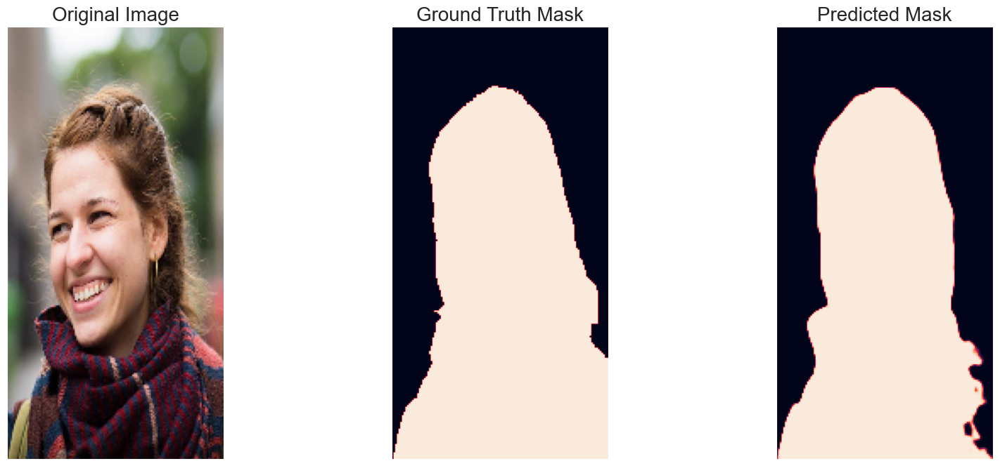

(1, 256, 128)


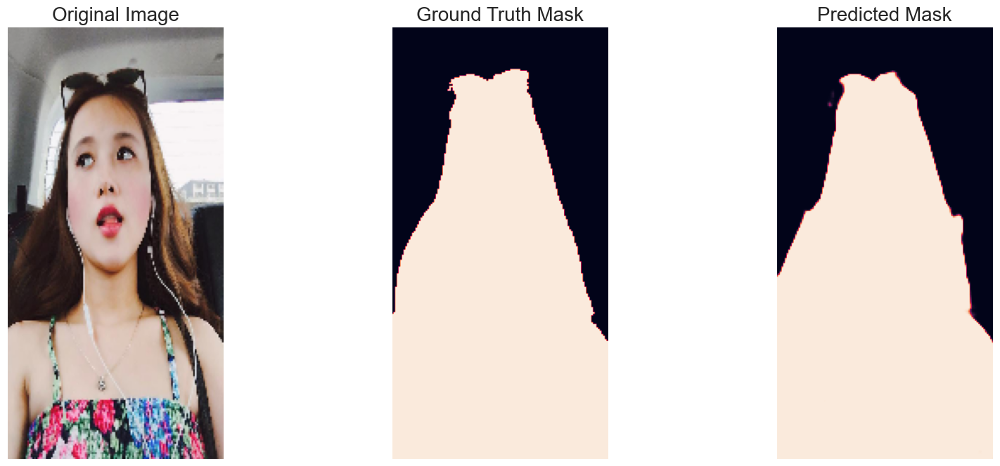

(1, 256, 128)


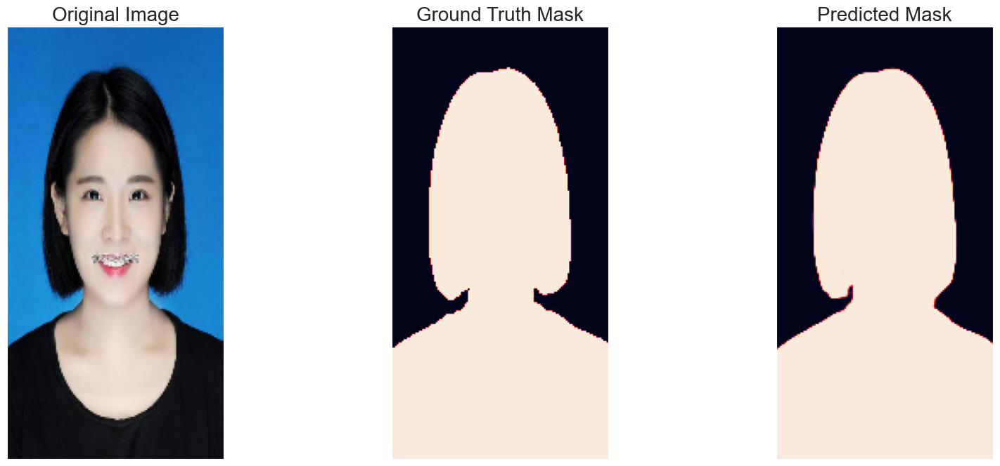

(1, 256, 128)


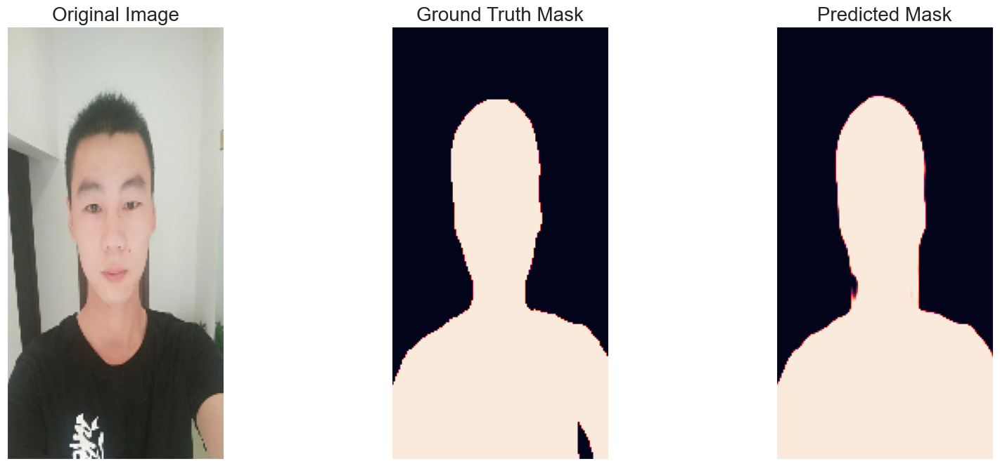

(1, 256, 128)


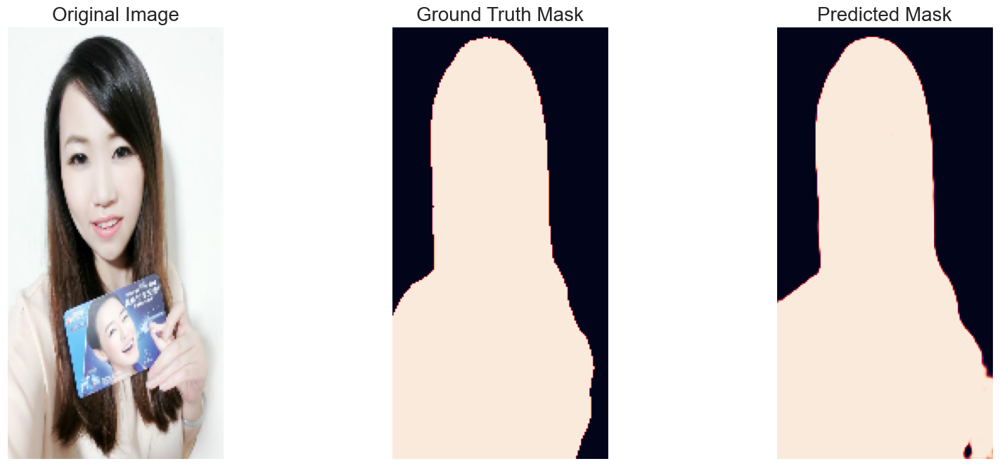

(1, 256, 128)


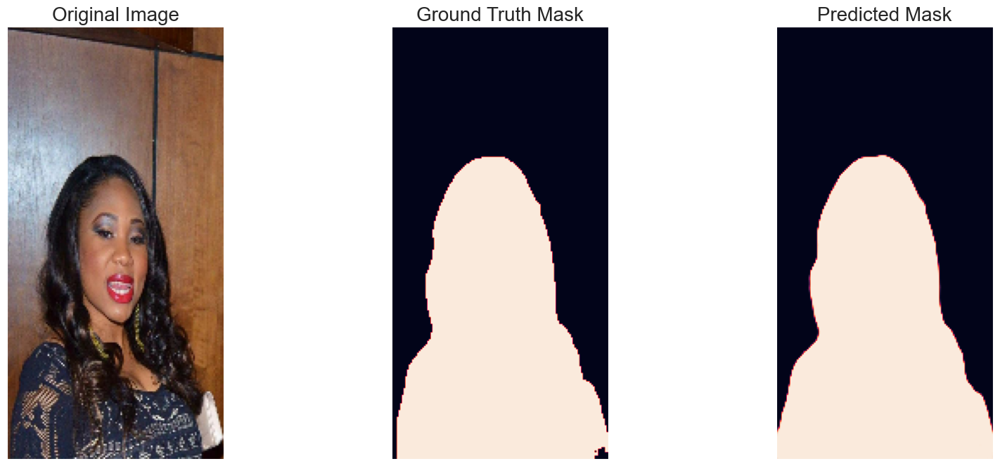

(1, 256, 128)


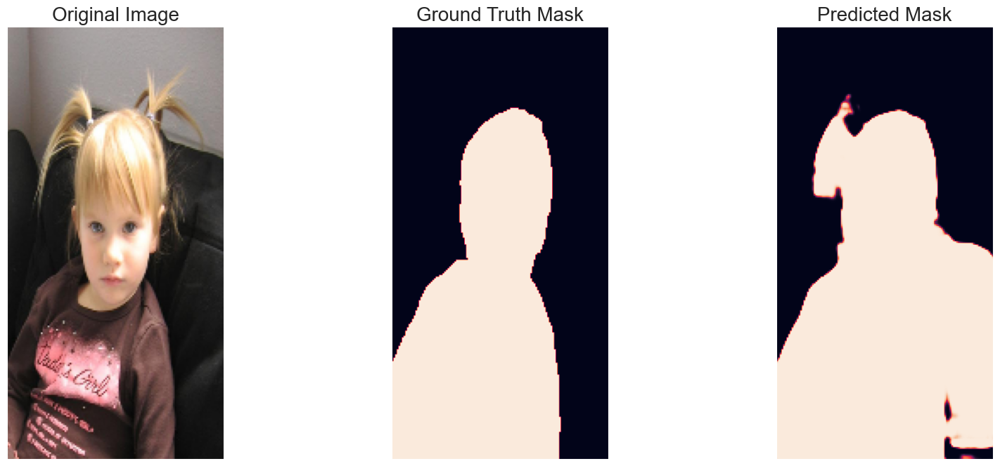

In [68]:
from hw.task3.dataset import SelfieDataset

# load best saved model checkpoint from the current run
if os.path.exists('manet_pretrained_encoder/best_modelV2.pth'):
    best_model = torch.load('manet_pretrained_encoder/best_modelV2.pth', map_location=DEVICE)
    print('Loaded UNet model from this run.')
    
test_dataset = SelfieDataset(img_dir=TEST_IMG_PATH, mask_dir=TEST_MASK_PATH, transform=val_transforms)

for idx in range(min(len(test_dataset), 15)):

    image, gt_mask = test_dataset[idx]

    x_tensor = image.to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze(0).cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    print(pred_mask.shape)
    pred_mask = np.transpose(pred_mask,(1,2,0))

    # pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = gt_mask.unsqueeze(0)
    gt_mask = np.transpose(gt_mask,(1,2,0))
    image = np.transpose(image,(1,2,0))
    # gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
    # cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.png"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])
    
    visualize(
        original_image = image,
        ground_truth_mask = gt_mask,
        predicted_mask = pred_mask,
    )

#### Result

Как мы можем заметить по графикам([jaccard](manet_pretrained_encoder/iou_score_plot.png) и [dice](manet_pretrained_encoder/dice_loss_plot.png)) удалось обучиться до точности
- Accuracy: 0.989261
- Jaccard: 0.978720

Данные показатели являются довольно высокими, однако проигрывают UNET с предобученным Encoder, а также по качеству контуров, как можно заметить на примерах выше, уступают собственной реализации UNET без предобученных частей.

# Conclusion

Исходя из проведенной выше работы, можно получить следующий топ:
1. PretrainedUnetResNet50
    - Accuracy 0.988
    - Jaccard 0.98
2. PretrainedMANetResNet50
   - Accuracy 0.989
   - Jaccard 0.978
3. SimpleFull
    - Accuracy 0.981
    - Dice 0.98
    - Jaccard 0.96
4. AugFull
    - Accuracy 0.781
    - Dice 0.74
    - Jaccard 0.59

Таким образом, наилучших результатов удалось достичь при помощи PretrainedUnetResNet50 и PretrainedMANetResNet50, однако по примерам полученных масок, PretrainedUnetResNet50 справляется со своей работой отличимо лучше. Примеры работ каждой из моделей приведены в соответствующих блоках.